<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/code/transformers/ImageCaptiongenerator_Transformer_Resnet50_No_MHA_Flickr30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [2]:
import os
os.chdir('/content/drive/MyDrive/Project_Data/Flickr30k')

In [3]:
!pwd

/content/drive/MyDrive/Project_Data/Flickr30k


In [5]:
!ls

Flickr30_comments     image_caption_flickr30_transformer50_resnet50.h5
Flickr30_images       image_caption_flickr30_transformer50_resnet70.pkl
Flickr30k_images.zip  image_caption_tokenizer.pkl
Flickr30_npy


In [ ]:
#!!7z x "/content/drive/MyDrive/Project_Data/Flickr30k/Images.zip"


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.30GHz (306F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/Project_Data/Flickr30k/                                                        1 file, 4375126936 bytes (4173 MiB)

Extracting archive: /content/drive/MyDrive/Project_Data/Flickr30k/Images.zip
  0% 256 Open               1% 512 Open               2% 768 Open               3% 1024 Open                4% 1280 Open                4% 1536 Open                5% 1792 Open                6% 2048 Open              

                                   51% 16835 - Images/3743157427.jpg                                   51% 16836 - Images/3743169025.jpg                                   51% 16837 - Images/3743976841.jpg                                   51% 16838 - Images/3744182161.jpg                                   51% 16839 - Images/374437796.jpg                                  51% 16840 - Images/374437808.jpg                                  51% 16841 - Images/374437845.jpg                        

In [ ]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [6]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [9]:
import fnmatch
image_path = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images"
dir_Flickr_text = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_comments/captions.txt"

#jpgs = os.listdir(image_path)
jpgs = fnmatch.filter(os.listdir(image_path),'*.jpg')
npys = fnmatch.filter(os.listdir(image_path),'*.npy')
print("Total Images in Dataset = {}".format(len(jpgs)))
print("Total npy in Dataset = {}".format(len(npys)))

Total Images in Dataset = 31783
Total npy in Dataset = 31783


In [ ]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [10]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('|')
    if len(col) == 1:
        continue
    #w = col[0].split("#")
    datatxt.append(col)

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000092795.jpg,Two young guys with shaggy hair look at their ...
1,1,1000092795.jpg,"Two young , White males are outside near many ..."
2,2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,4,1000092795.jpg,Two friends enjoy time spent together .


Print some images along with captions to check the Flickr Data that was imported

In [11]:
data.size

476745

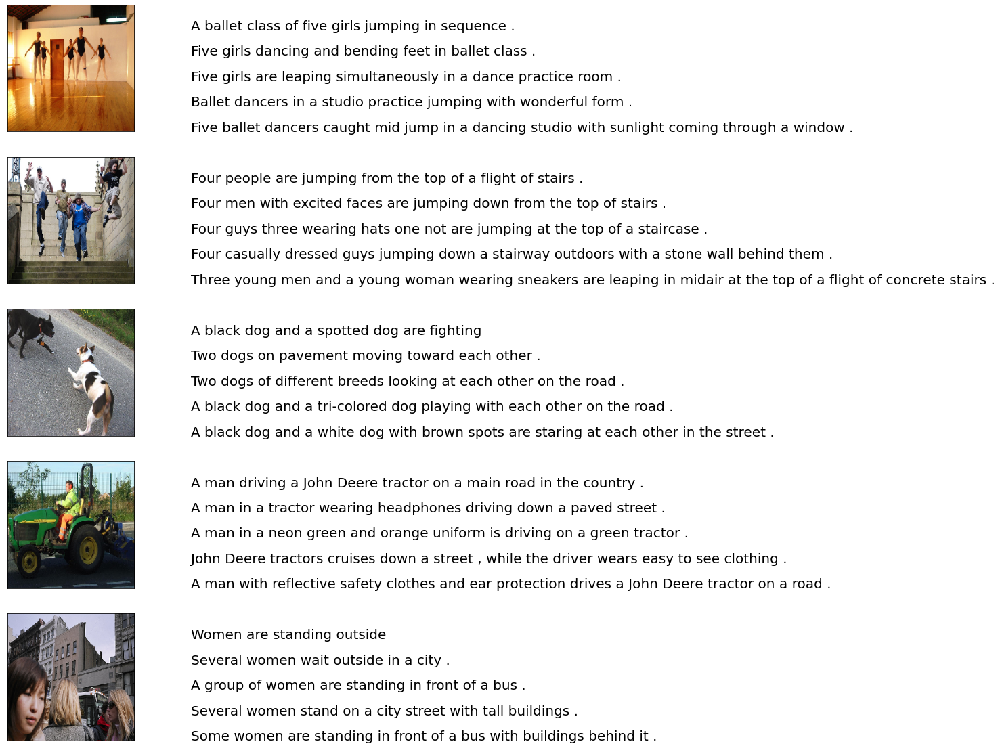

In [12]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [13]:
# Get all the words available i the captions by splitting the sentences

In [14]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 23538


In [15]:
# crearting a list of Image file names and captions

In [16]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [17]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 158915
len(caption) : 158915


In [18]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [19]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [20]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [21]:
#building clean vocabulary
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 20924


In [22]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence
PATH = "/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  Two young guys with shaggy hair look at their hands while hanging out in the yard <end>',
 '<start>  Two young White males are outside near many bushes <end>',
 '<start>  Two men in green shirts are standing in yard <end>',
 '<start>  man in blue shirt standing in garden <end>',
 '<start>  Two friends enjoy time spent together <end>',
 '<start>  Several men in hard hats are operating giant pulley system <end>',
 '<start>  Workers look down from up above on piece of equipment <end>',
 '<start>  Two men working on machine wearing hard hats <end>',
 '<start>  Four men on top of tall structure <end>',
 '<start>  Three men on large rig <end>']

In [23]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1000092795.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg',
 '/content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/10002456.jpg']

In [24]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [25]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [26]:
train_captions,img_name_vector = data_limiter(158000,all_captions,all_img_name_vector)

In [27]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 158000
len(all_captions) : 158000


In [74]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [76]:
#image_model_ic = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

94781440/94765736 [==============================] - 1s 0us/step


In [77]:
image_features_extract_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [ ]:
# Get unique images
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  # converting image from Resnet (16,7,7,2048) to (16,49,2048)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 1987/1987 [15:31<00:00,  2.13it/s]


In [ ]:
#temp code
#Run Selectively if the image converted to Numpy file using pretrained CNN file is built already
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/1987 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [28]:
top_k = 5000

In [29]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [30]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [31]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [32]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [33]:
cap_vector.shape # Maximum number of words in a sentence is 74 (in the captions dataset)

(158000, 74)

### Split the data into training and testing

In [34]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [35]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(126400, 126400, 31600, 31600)

### Create a tf.data dataset for training

In [ ]:
#Temp code
print(cap_train.shape)
print (type(cap_train))
cap_train[0,:]

(126400, 74)
<class 'numpy.ndarray'>


array([   2,  228, 1463,    9,  344,   60,   25,  365,   10,  463,    3,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0,    0,    0,    0,
          0,    0,    0,    0,    0,    0,    0,    0], dtype=int32)

In [36]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [37]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [38]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [39]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [40]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [41]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [42]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [43]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [44]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [45]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [46]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [47]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [48]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    out1 = x
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [49]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [50]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [51]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [52]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [53]:
print (target_vocab_size)

5001


In [54]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [55]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [56]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [57]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [58]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [59]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [60]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [61]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [62]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [63]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [64]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [65]:
@tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [66]:
 #temp code
 for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     print("tar1" , tar1.shape)
     print( tar1[:, :-1].shape)
     print( tar1[:, 1:].shape)
     dec_mask1 = create_masks_decoder(tar1[:, :-1])
     print(dec_mask1.shape)
     break

img_tensor1 (64, 49, 2048)
tar1 (64, 74)
(64, 73)
(64, 73)
(64, 1, 73, 73)


In [ ]:
#Run this only incrementally
from pickle import dump,load
pkl_transformer_file="image_caption_flickr30_transformer10_resnet50_nomha.pkl"
with open(pkl_transformer_file, "rb") as encoded_pickle_transformer:
    dump(transformer, encoded_pickle_transformer)

In [67]:
#Epochs = 70 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(10):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.6705 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.2551 Accuracy 0.0069
Epoch 1 Batch 100 Loss 7.8392 Accuracy 0.0103
Epoch 1 Batch 150 Loss 7.5430 Accuracy 0.0115
Epoch 1 Batch 200 Loss 7.2496 Accuracy 0.0136
Epoch 1 Batch 250 Loss 6.9730 Accuracy 0.0155
Epoch 1 Batch 300 Loss 6.7267 Accuracy 0.0174
Epoch 1 Batch 350 Loss 6.5166 Accuracy 0.0191
Epoch 1 Batch 400 Loss 6.3344 Accuracy 0.0207
Epoch 1 Batch 450 Loss 6.1796 Accuracy 0.0221
Epoch 1 Batch 500 Loss 6.0459 Accuracy 0.0232
Epoch 1 Batch 550 Loss 5.9256 Accuracy 0.0243
Epoch 1 Batch 600 Loss 5.8182 Accuracy 0.0253
Epoch 1 Batch 650 Loss 5.7230 Accuracy 0.0261
Epoch 1 Batch 700 Loss 5.6367 Accuracy 0.0268
Epoch 1 Batch 750 Loss 5.5577 Accuracy 0.0275
Epoch 1 Batch 800 Loss 5.4859 Accuracy 0.0281
Epoch 1 Batch 850 Loss 5.4189 Accuracy 0.0288
Epoch 1 Batch 900 Loss 5.3592 Accuracy 0.0293
Epoch 1 Batch 950 Loss 5.3027 Accuracy 0.0298
Epoch 1 Batch 1000 Loss 5.2496 Accuracy 0.0302
Epoch 1 Batch 1050 Loss 5.2026 Accur

In [68]:
transformer.save_weights('image_caption_flickr30_transformer10_resnet50_nomha.h5')

In [69]:
from pickle import dump,load
pkl_transformer_file="image_caption_flickr30_transformer10_resnet50_nomha.pkl"
with open(pkl_transformer_file, "wb") as encoded_pickle_transformer:
    dump(transformer, encoded_pickle_transformer)

In [70]:
pkl_tokenizer_file="image_caption_tokenizer.pkl"
with open(pkl_tokenizer_file, "wb") as encoded_pickle_tokenizer:
    dump(tokenizer, encoded_pickle_tokenizer)

In [71]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
  #print ("start_token", start_token)
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  #print ("output1", output.shape)
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
      #print ("dec_mask", dec_mask.shape)
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4559328276.jpg
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229
Real Caption: woman and girl are sitting under tree
Predicted Caption: man in red shirt and black pants is playing the street


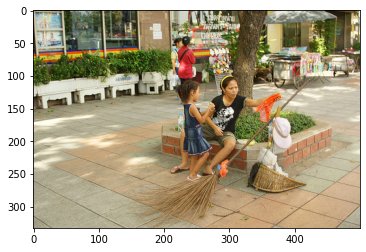

In [78]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
print("image",image)
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 16.374615061559638
BLEU-2 score: 12.204917461013086
BLEU-3 score: 1.3224543177847158e-91
BLEU-4 score: 4.715309358549606e-153
Real Caption: three people are looking at the ground near table and several chairs
Predicted Caption: two people are standing in front of large white house


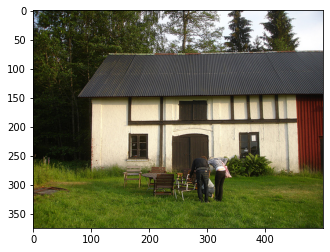

In [79]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 3.3333333333333335
BLEU-2 score: 2.7234009733585947e-153
BLEU-3 score: 9.231457666116119e-184
BLEU-4 score: 7.784451369270533e-230
Real Caption: an older man talking with young woman holding blue folder
Predicted Caption: woman in red dress and black boots and black and black and black and black and black and black and black and black and black and black and black purse


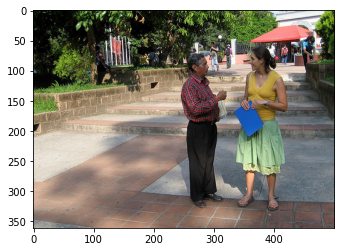

In [80]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6942665770.jpg
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Real Caption: dog has its photo taken with big bow made of ribbon on its head
Predicted Caption: two dogs are standing in the camera


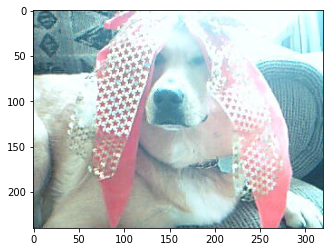

In [81]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
print("image",image)
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


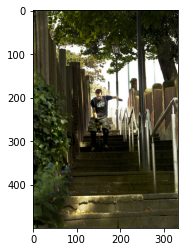

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3518118675.jpg
Real Caption: man riding unicycle down set of stairs
Predicted Caption: two people walking down the sidewalk
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


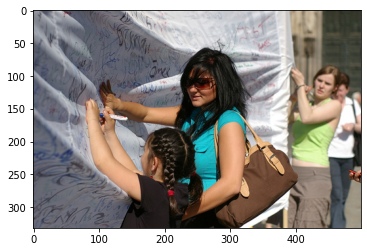

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2511787709.jpg
Real Caption: woman helps little girl <unk> something on banner
Predicted Caption: woman in black shirt is standing in front of the background
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


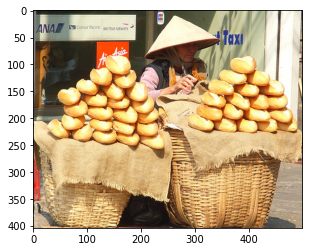

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1157215900.jpg
Real Caption: person is sitting behind two large baskets of bread
Predicted Caption: man in red shirt is standing in front of
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


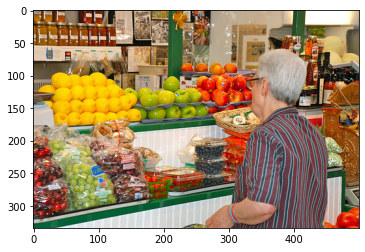

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4727473684.jpg
Real Caption: an older gentleman is shopping for produce
Predicted Caption: man in red shirt is standing in front of
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


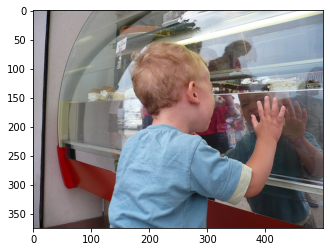

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1464120327.jpg
Real Caption: little boy peering into glass display case
Predicted Caption: man in blue shirt is sitting in front of the camera
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


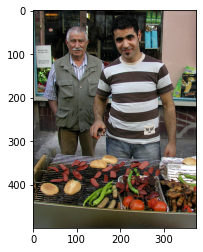

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/484814224.jpg
Real Caption: man stands with his father and shows all the food on his grill
Predicted Caption: man in blue shirt is standing in front of food
BLEU-1 score: 14.816364413634359
BLEU-2 score: 4.941955938122807e-153
BLEU-3 score: 1.1706506563935077e-183
BLEU-4 score: 9.025629002083406e-230


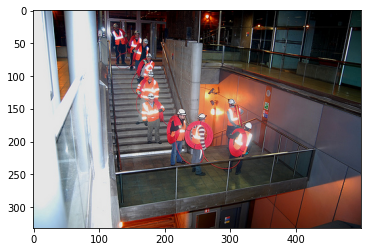

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2537624884.jpg
Real Caption: emergency workers with hoses lined up and descending down stairs
Predicted Caption: two men are working on the side of an orange vests are on the background
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


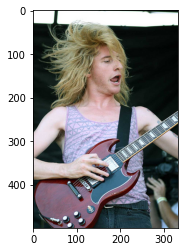

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2662537919.jpg
Real Caption: man with long playing red guitar
Predicted Caption: woman in red shirt is playing the guitar
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229


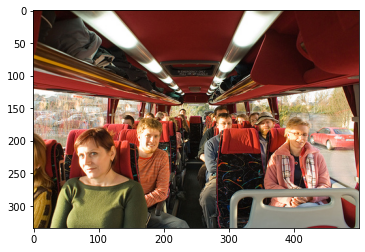

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/418685848.jpg
Real Caption: people ride on bus with red seats
Predicted Caption: group of people are sitting on the camera
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


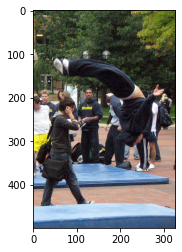

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2924825127.jpg
Real Caption: man <unk> as spectators watch at the university of <unk>
Predicted Caption: two men are playing with dog
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


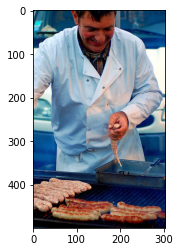

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2081721157.jpg
Real Caption: man cooks sausages dressed in <unk> chef clothing
Predicted Caption: man in blue shirt is holding chicken
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


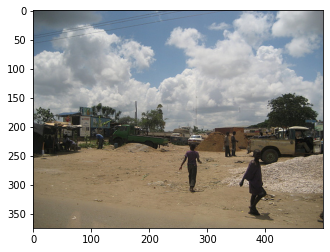

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2573811416.jpg
Real Caption: some people wandering near construction field
Predicted Caption: group of people are walking along dirt road
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


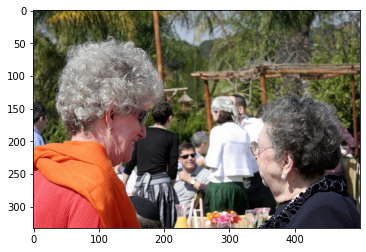

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2230971412.jpg
Real Caption: two elderly woman are talking at gathering
Predicted Caption: woman in red shirt is standing in front of people
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


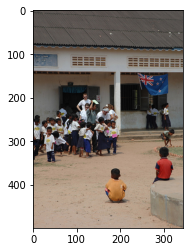

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/208473386.jpg
Real Caption: the school children <unk> uniforms of white shirts and navy pants or skirts and yellow name tags
Predicted Caption: group of people are standing in front of people
BLEU-1 score: 4.567914338968749
BLEU-2 score: 2.0441436942578786e-153
BLEU-3 score: 5.446209790456202e-184
BLEU-4 score: 4.324223740015325e-230


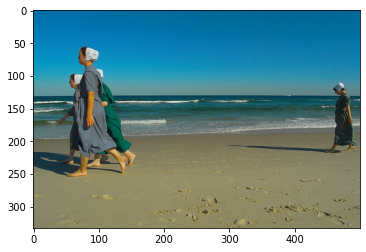

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1466752561.jpg
Real Caption: four <unk> walking along the beach
Predicted Caption: two women in the beach
BLEU-1 score: 32.749230123119276
BLEU-2 score: 25.890539701513365
BLEU-3 score: 2.0765597558437652e-91
BLEU-4 score: 6.867731683891005e-153


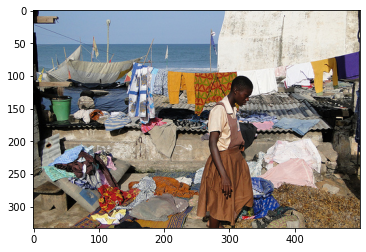

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4721642270.jpg
Real Caption: woman hanging laundry to dry outdoors near the ocean
Predicted Caption: man in blue shirt and black shirt is standing in front of them
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


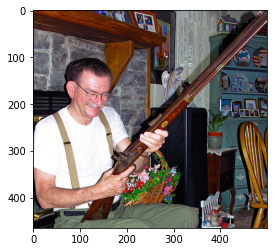

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/182030893.jpg
Real Caption: an older smiling gentleman is examining rifle in his home
Predicted Caption: man in red shirt is playing the drums
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229


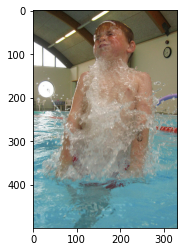

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2660008870.jpg
Real Caption: boy is making splash in swimming pool
Predicted Caption: man in blue shirt and goggles is swimming pool
BLEU-1 score: 44.44444444444444
BLEU-2 score: 23.570226039551585
BLEU-3 score: 2.1262855015914923e-91
BLEU-4 score: 7.241926111174567e-153


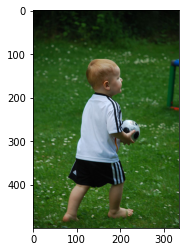

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2966269757.jpg
Real Caption: small kid carrying soccer ball
Predicted Caption: young boy in blue shirt and white shirt is walking in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


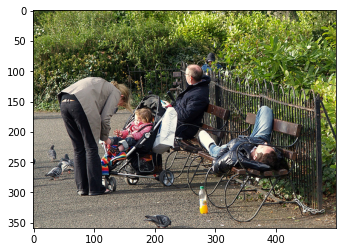

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3471841031.jpg
Real Caption: the woman helps her child as the men sit and lay on the bench
Predicted Caption: man and woman are sitting on bench
BLEU-1 score: 21.021682352653848
BLEU-2 score: 4.148190661436244e-153
BLEU-3 score: 7.965274779648174e-184
BLEU-4 score: 5.827124933825783e-230


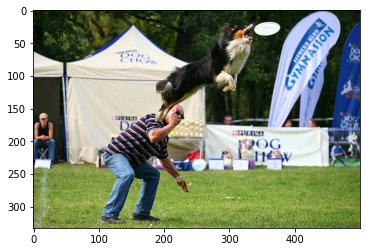

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2839807428.jpg
Real Caption: dog jumping high in the air to catch frisbee
Predicted Caption: man in black shirt and black pants is jumping over an obstacle course
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


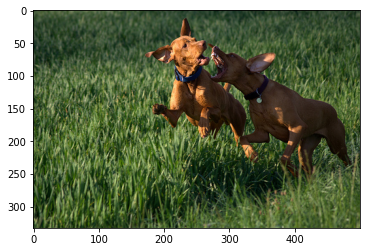

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/485566887.jpg
Real Caption: two brown dogs with blue collars are running in the grass
Predicted Caption: two brown dogs are playing with each other
BLEU-1 score: 42.95557992443577
BLEU-2 score: 29.04327290997419
BLEU-3 score: 23.94626509811946
BLEU-4 score: 3.486509539245492e-76


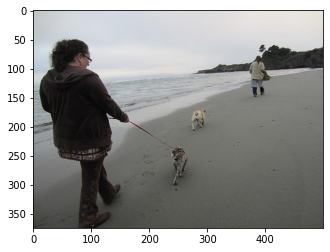

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7338940816.jpg
Real Caption: woman wearing brown jacket and brown pants is walking her two dogs along the beach as they follow another person
Predicted Caption: two boys are playing in the beach
BLEU-1 score: 6.690773370684473
BLEU-2 score: 4.172430267608656
BLEU-3 score: 3.5794642047477666e-92
BLEU-4 score: 1.2039080317728253e-153


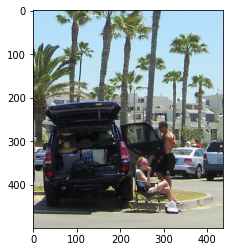

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/157616263.jpg
Real Caption: woman is sitting in chair while man is going through the sport utility vehicle
Predicted Caption: man and woman are sitting on the street
BLEU-1 score: 23.618327637050733
BLEU-2 score: 4.982374365655583e-153
BLEU-3 score: 9.826000880602376e-184
BLEU-4 score: 7.236523273960502e-230


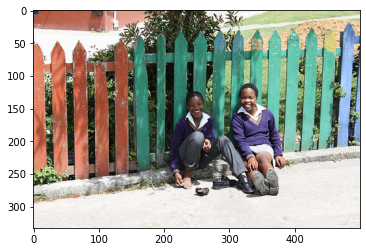

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4069578876.jpg
Real Caption: black girls in purple shirts sitting near green fence
Predicted Caption: two men are sitting on the street
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


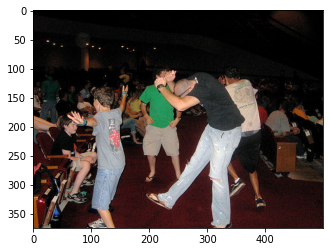

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/24710703.jpg
Real Caption: at some kind of large seated event man and child make strange poses
Predicted Caption: group of people are dancing
BLEU-1 score: 4.037930359893108
BLEU-2 score: 1.3468401129116942e-153
BLEU-3 score: 3.1903952240336635e-184
BLEU-4 score: 2.459770855197576e-230


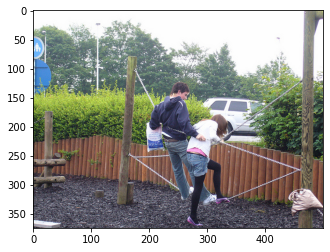

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2466712155.jpg
Real Caption: the two young are playing in the chain
Predicted Caption: two men are sitting on swing set of an orange vest and blue shirt and blue shirt and blue jeans
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


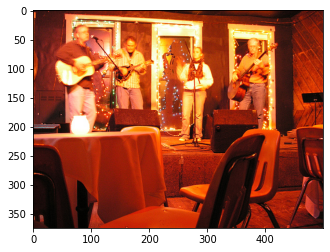

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/446714977.jpg
Real Caption: four musicians playing guitars in club
Predicted Caption: man and woman are sitting in front of an audience
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


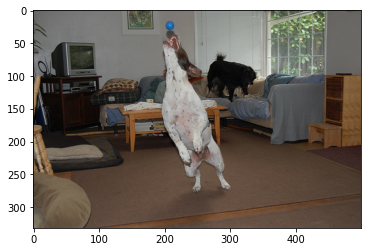

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1425069308.jpg
Real Caption: two dogs in family room are playing one is catching ball in its mouth
Predicted Caption: two dogs are playing with each other
BLEU-1 score: 21.021682352653848
BLEU-2 score: 16.0555751027256
BLEU-3 score: 1.1320381331999133e-91
BLEU-4 score: 3.625249555356891e-153


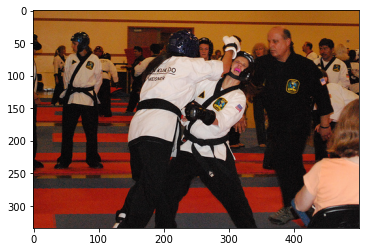

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2701892929.jpg
Real Caption: two men dressed in martial arts outfits fight in an area while others in uniforms stand around
Predicted Caption: two men are playing game
BLEU-1 score: 3.6287181315765005
BLEU-2 score: 2.868753570633078
BLEU-3 score: 2.300893794756061e-92
BLEU-4 score: 7.60966361360193e-154


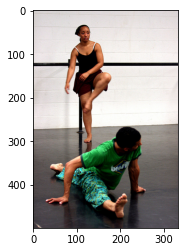

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3681967973.jpg
Real Caption: man does the splits wearing green and woman in black leotard stands on one leg near black ballet bar in studio
Predicted Caption: two children are dancing on the air
BLEU-1 score: 3.8667223781889337
BLEU-2 score: 1.0790690338459086e-153
BLEU-3 score: 2.380111384945217e-184
BLEU-4 score: 1.8026123769762792e-230


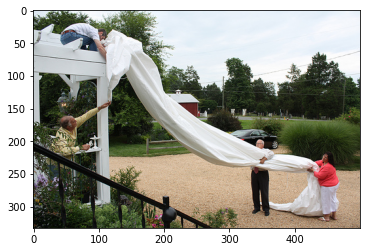

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3692055291.jpg
Real Caption: four people are trying to hang large white piece of fabric onto an outdoor pavilion
Predicted Caption: two women are sitting on the grass
BLEU-1 score: 4.555807961771006
BLEU-2 score: 1.7979874041745804e-153
BLEU-3 score: 4.555548724925179e-184
BLEU-4 score: 3.571883312829026e-230


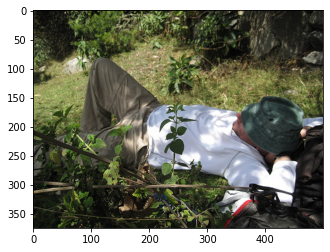

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3826491809.jpg
Real Caption: man wearing white shirt taking nap with green hat over his eyes
Predicted Caption: man in blue shirt and black shirt and one of them
BLEU-1 score: 16.601831205132044
BLEU-2 score: 5.807771944031223e-153
BLEU-3 score: 1.4022212212919266e-183
BLEU-4 score: 1.0862663708453602e-229


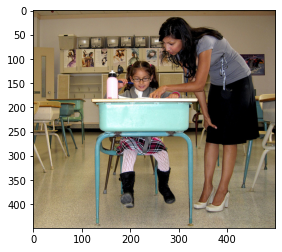

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3863054776.jpg
Real Caption: woman helps young girl in classroom
Predicted Caption: two women are sitting on the floor
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


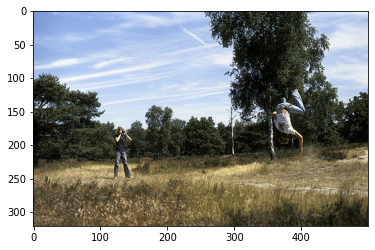

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/207237775.jpg
Real Caption: man doing back flip while another takes picture
Predicted Caption: two people are walking through field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


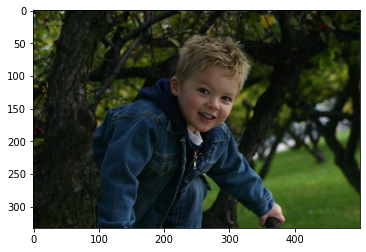

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/299178969.jpg
Real Caption: boy in blue in trees
Predicted Caption: young boy in blue shirt is playing with his hand
BLEU-1 score: 30.0
BLEU-2 score: 25.819888974716104
BLEU-3 score: 23.781849487482358
BLEU-4 score: 3.6901226086395757e-76


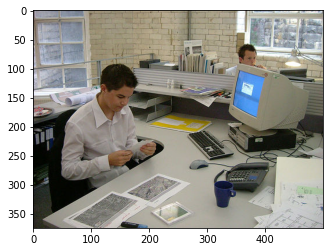

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3787801.jpg
Real Caption: man is busy at work examining photographs
Predicted Caption: man in black shirt is sitting on the floor
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


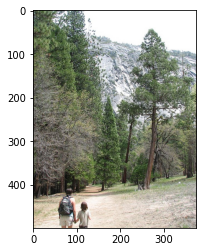

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/480845172.jpg
Real Caption: child is holding their parent hand while walking in forrest
Predicted Caption: two people walking down dirt road
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230


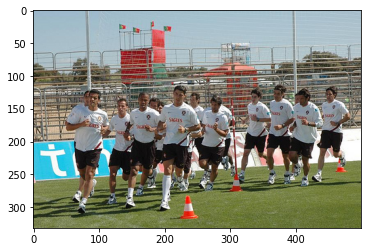

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3313232606.jpg
Real Caption: group of people in matching uniforms jogging around track
Predicted Caption: group of people are playing soccer game
BLEU-1 score: 32.206169703226536
BLEU-2 score: 28.4031719055601
BLEU-3 score: 25.863985552473196
BLEU-4 score: 3.773418367399459e-76


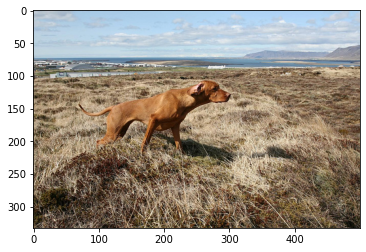

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3623650392.jpg
Real Caption: brown dog standing in the middle of huge field
Predicted Caption: dog runs through field with dog on the grass
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


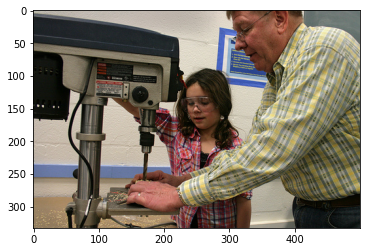

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4297527221.jpg
Real Caption: man in plaid showing young girl also in plaid how to drill hole
Predicted Caption: woman in black shirt is standing in front of them
BLEU-1 score: 14.816364413634359
BLEU-2 score: 4.941955938122807e-153
BLEU-3 score: 1.1706506563935077e-183
BLEU-4 score: 9.025629002083406e-230


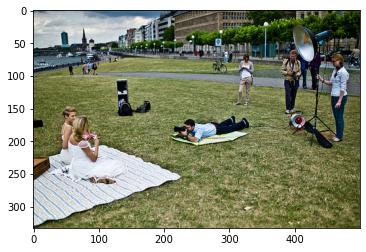

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4824078556.jpg
Real Caption: two women in white dresses getting their pictures taken
Predicted Caption: group of people are sitting on the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


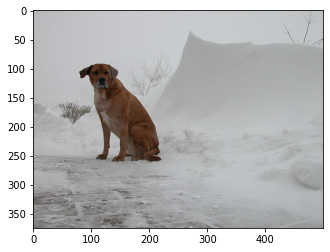

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2130203183.jpg
Real Caption: the dog sits by <unk>
Predicted Caption: two dogs are standing in the snow
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


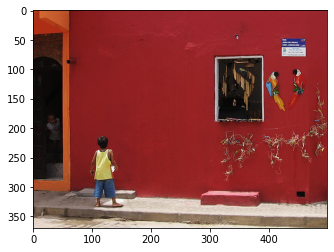

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2103812912.jpg
Real Caption: two children in front of red building
Predicted Caption: two people are standing in front of an orange and white wall
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76


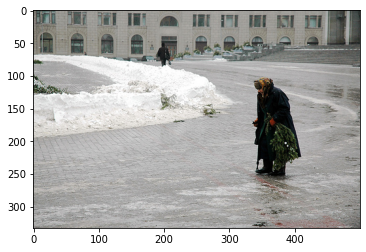

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1542401004.jpg
Real Caption: woman with cane is standing bundled up in winter weather
Predicted Caption: man in red coat and black jacket and carrying bag
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


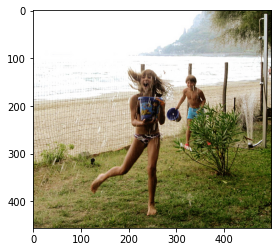

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2830869109.jpg
Real Caption: girl with bucket of water is being chased by boy with bucket of water
Predicted Caption: two women are playing in field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


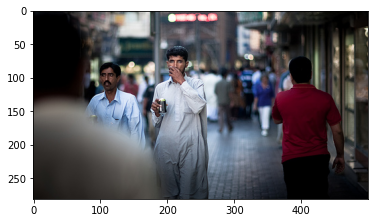

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4456044325.jpg
Real Caption: men are walking down busy street
Predicted Caption: man in black shirt is walking down the street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


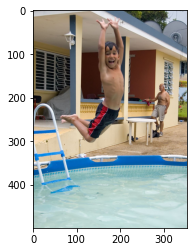

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/578644583.jpg
Real Caption: little boy in black shorts jumps into backyard pool next to yellow <unk> house
Predicted Caption: young boy is jumping on the floor
BLEU-1 score: 5.255420588163462
BLEU-2 score: 2.0740953307181176e-153
BLEU-3 score: 5.255121541612728e-184
BLEU-4 score: 4.120399555529536e-230


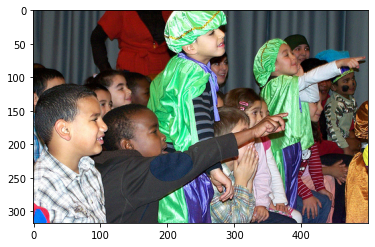

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3107368071.jpg
Real Caption: group of kids are excited by what they are watching
Predicted Caption: man and woman are sitting on the same direction of people
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


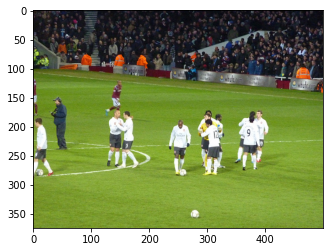

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4242784332.jpg
Real Caption: soccer players converse as spectators look on
Predicted Caption: soccer game is being played
BLEU-1 score: 13.406400920712787
BLEU-2 score: 4.471666651098519e-153
BLEU-3 score: 1.0592485173532028e-183
BLEU-4 score: 8.166726842395623e-230


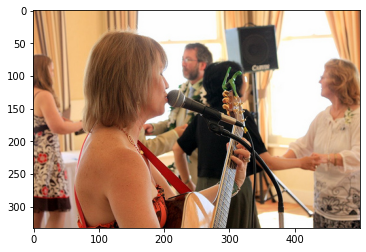

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3978531966.jpg
Real Caption: woman singing into microphone and playing guitar at an event
Predicted Caption: woman in red shirt is sitting on the other people
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


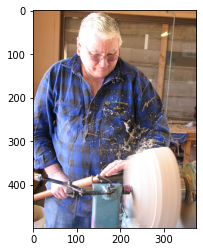

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1447077067.jpg
Real Caption: man enjoying his craft of woodworking
Predicted Caption: man in blue shirt is using power saw
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


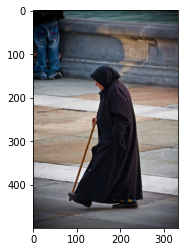

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3564335184.jpg
Real Caption: person in long <unk> and cane walking
Predicted Caption: man in blue coat and black pants and carrying plastic bag
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


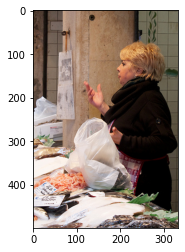

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4622779689.jpg
Real Caption: blond woman in brown is selling <unk>
Predicted Caption: man in red shirt and black shirt is sitting on the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


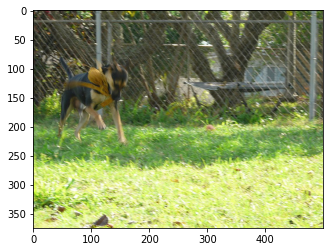

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3076928208.jpg
Real Caption: the dog by the fence is running on the grass
Predicted Caption: two dogs are playing in the grass
BLEU-1 score: 18.612544500887303
BLEU-2 score: 14.215565675175021
BLEU-3 score: 1.3225476692186996e-91
BLEU-4 score: 4.539324034745998e-153


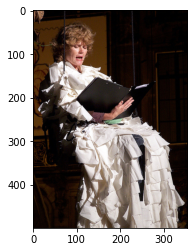

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/536147209.jpg
Real Caption: woman in costume sits on suspended swing on stage and reads from binder
Predicted Caption: man in white shirt is sitting on the camera
BLEU-1 score: 14.248453076221212
BLEU-2 score: 4.5086465338368087e-153
BLEU-3 score: 1.0457385906395474e-183
BLEU-4 score: 8.020204191025903e-230


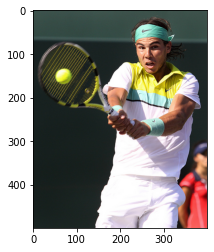

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3425853460.jpg
Real Caption: man is hitting tennis ball in professional match
Predicted Caption: man in white shirt and white shorts playing tennis ball
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


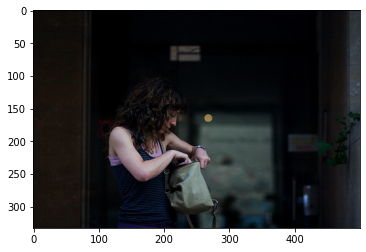

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4970400551.jpg
Real Caption: woman searching in her purse for something
Predicted Caption: woman in black shirt is holding camera
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


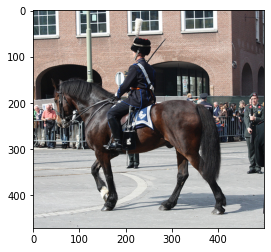

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5171265627.jpg
Real Caption: man in uniform is riding horse in parade
Predicted Caption: man in blue shirt and black vest is riding brown horse
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


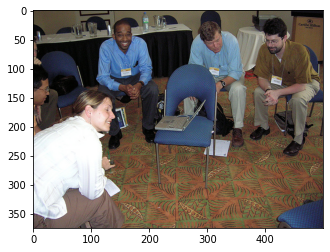

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/117883760.jpg
Real Caption: people sitting in circle with book in the middle
Predicted Caption: three people are sitting on the floor
BLEU-1 score: 32.206169703226536
BLEU-2 score: 7.33837135698786e-153
BLEU-3 score: 1.4925520509868707e-183
BLEU-4 score: 1.1077199809555582e-229


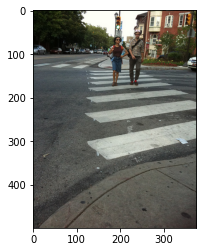

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4729191874.jpg
Real Caption: two young adults crossing the street using crosswalk
Predicted Caption: man in black shirt and black pants is walking down the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


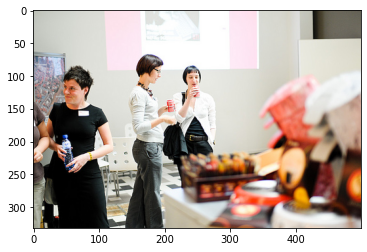

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2494519230.jpg
Real Caption: women talking to each other
Predicted Caption: man in black shirt is standing around talking to man in front of people
BLEU-1 score: 14.285714285714285
BLEU-2 score: 10.482848367219184
BLEU-3 score: 1.3076481741058403e-91
BLEU-4 score: 4.829607837557234e-153


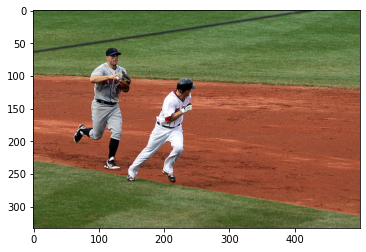

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3575330336.jpg
Real Caption: baseball player running to avoid being tagged out between first and second base
Predicted Caption: two men are playing baseball
BLEU-1 score: 4.037930359893108
BLEU-2 score: 1.3468401129116942e-153
BLEU-3 score: 3.1903952240336635e-184
BLEU-4 score: 2.459770855197576e-230


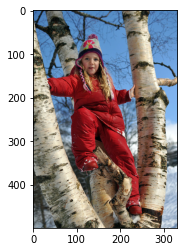

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4504478051.jpg
Real Caption: little girl in tree during the winter
Predicted Caption: young girl in red shirt and red shirt and blue rope
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


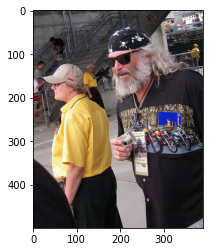

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3760010229.jpg
Real Caption: elderly man with long hair and beard holding camera and walking at an event
Predicted Caption: man in red shirt is standing in front of people
BLEU-1 score: 6.703200460356394
BLEU-2 score: 3.1619458121975893e-153
BLEU-3 score: 8.603771465569229e-184
BLEU-4 score: 6.867371326126471e-230


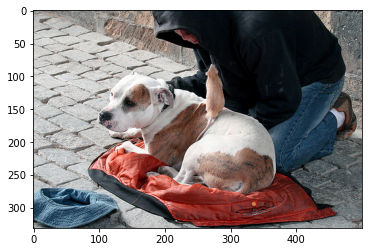

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3183777589.jpg
Real Caption: dog sits on red blanket with man in dark hoodie
Predicted Caption: two dogs are playing with stuffed animal
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


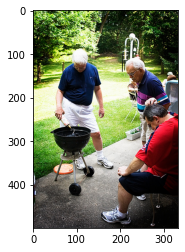

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2675365025.jpg
Real Caption: group of elderly men are lighting cooking grill
Predicted Caption: man in blue shirt is playing the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


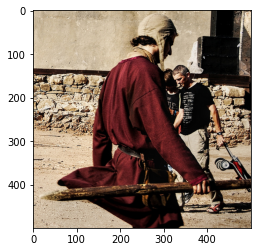

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4683340079.jpg
Real Caption: man wearing dark red robe carrying wooden stick
Predicted Caption: man in blue shirt is sitting on the street
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


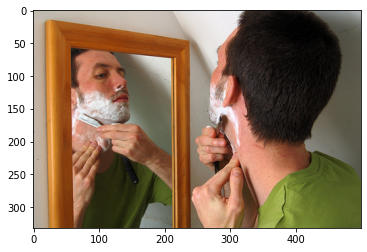

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/350938953.jpg
Real Caption: man in green looks at his reflection while shaving using straight razor
Predicted Caption: man and woman are looking at the camera
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230


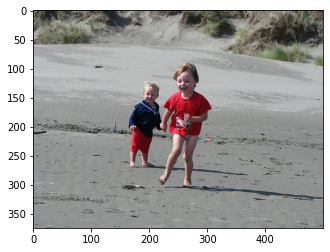

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3278581900.jpg
Real Caption: two young children are on sand
Predicted Caption: two young boys are walking on the beach
BLEU-1 score: 50.0
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153


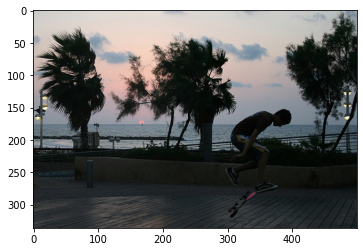

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1604212051.jpg
Real Caption: young man skateboarding in front of the ocean
Predicted Caption: man in black shirt and black pants is walking down the background
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


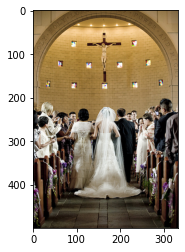

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2807437977.jpg
Real Caption: bride and groom walking down the isle in church
Predicted Caption: group of people are standing in front of people
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


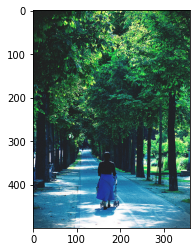

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4910904772.jpg
Real Caption: woman pushing stroller down walkway
Predicted Caption: man in blue shirt and black pants and black pants and holding an
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


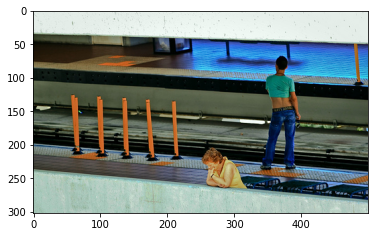

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4429773871.jpg
Real Caption: two people wait on train one in yellow shirt and one that looks like male in green belly shirt
Predicted Caption: man in red shirt and black pants is walking down
BLEU-1 score: 12.197089792217975
BLEU-2 score: 7.422912461237536
BLEU-3 score: 7.41654983519747e-92
BLEU-4 score: 2.5913547346414774e-153


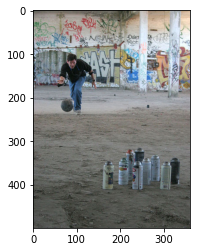

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/17744613.jpg
Real Caption: man in black shirt is rolling bowling ball towards set up of spray paint cans
Predicted Caption: man in black shirt and black pants is walking down the background
BLEU-1 score: 32.450032627975204
BLEU-2 score: 26.25336904165032
BLEU-3 score: 25.025950232588844
BLEU-4 score: 17.458325365356693


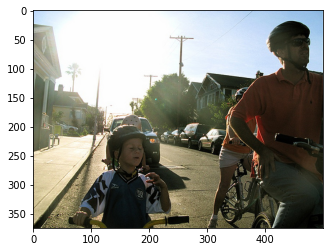

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3014071227.jpg
Real Caption: lot of people are riding bikes
Predicted Caption: man and woman are walking down the street
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


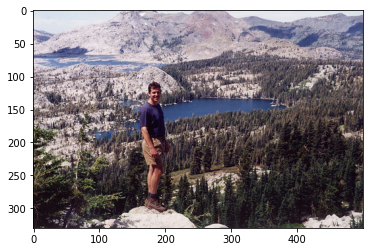

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3081330705.jpg
Real Caption: the man has blue shirt on and is standing in front of some snowy mountains
Predicted Caption: man in blue shirt and black pants is standing on the background
BLEU-1 score: 58.41005873035536
BLEU-2 score: 28.759124869239333
BLEU-3 score: 2.1679001784347246e-91
BLEU-4 score: 7.059488558713305e-153


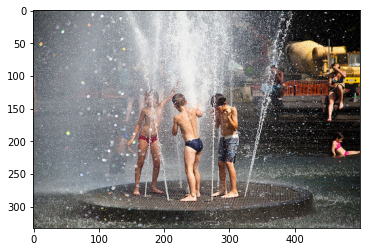

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4805613386.jpg
Real Caption: children playing in the water <unk> in park
Predicted Caption: two children are playing in the water
BLEU-1 score: 61.91984998215584
BLEU-2 score: 51.80586332905649
BLEU-3 score: 48.35356722608987
BLEU-4 score: 37.68499164492419


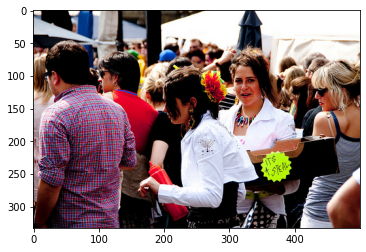

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4676386270.jpg
Real Caption: woman with box stands in crowd
Predicted Caption: group of people are walking down the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


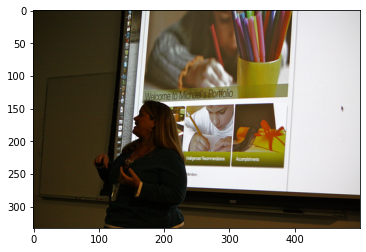

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3335322101.jpg
Real Caption: woman giving presentation using <unk> projection
Predicted Caption: man in blue shirt is standing in front of an airport
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


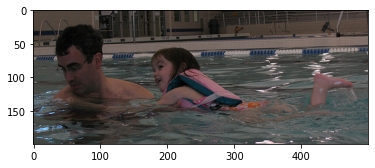

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3051022611.jpg
Real Caption: little girl learning how to swim
Predicted Caption: two young girls are playing in the pool
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


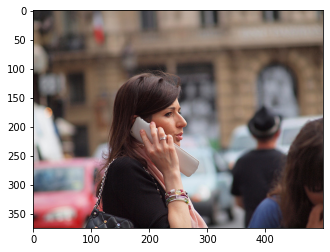

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4857774876.jpg
Real Caption: woman talking outside on cellphone
Predicted Caption: woman in black shirt is walking down the street
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


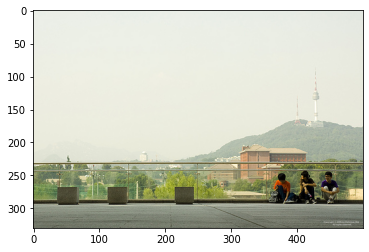

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4950966242.jpg
Real Caption: three young males sit down on the floor with view of the mountain and <unk> tower in the background
Predicted Caption: man in black shirt and black pants is standing on the background
BLEU-1 score: 23.251464407085294
BLEU-2 score: 15.359411878995713
BLEU-3 score: 1.3022450109762912e-91
BLEU-4 score: 4.367071325528012e-153


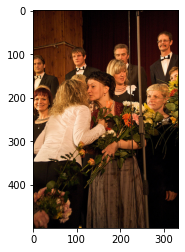

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3041785224.jpg
Real Caption: people standing around wearing formal wear
Predicted Caption: man and woman are sitting at table
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


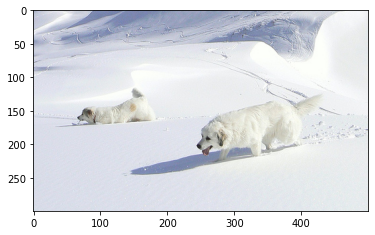

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2148695079.jpg
Real Caption: two fluffy white dogs are in the snow
Predicted Caption: dog is running through the snow
BLEU-1 score: 23.88437701912631
BLEU-2 score: 18.500758885923073
BLEU-3 score: 1.609204077733313e-91
BLEU-4 score: 5.431059661402121e-153


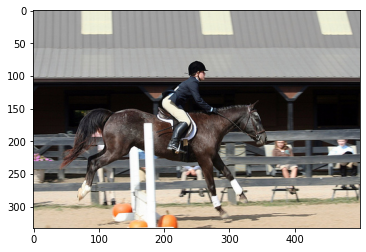

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2951750234.jpg
Real Caption: an equestrian and horse are jumping over an obstacle
Predicted Caption: man in black shirt and black vest is jumping over an obstacle course
BLEU-1 score: 38.46153846153847
BLEU-2 score: 31.008683647302114
BLEU-3 score: 29.701692076911158
BLEU-4 score: 20.44800736021839


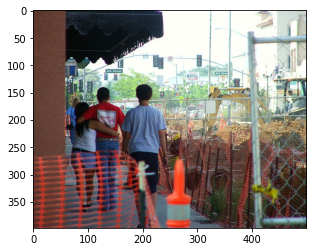

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/185571867.jpg
Real Caption: three people walk past construction zone fenced off with orange plastic fencing
Predicted Caption: two men are standing in front of an outdoor event
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


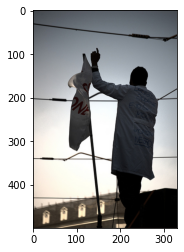

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2988552985.jpg
Real Caption: man in jacket and mask stands behind series of wires next to flag
Predicted Caption: man in red shirt and black pants is standing on top of building
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153


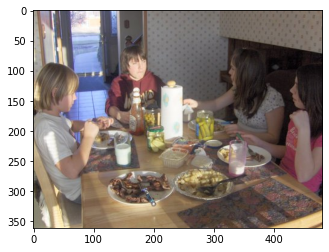

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/418112325.jpg
Real Caption: four kids sitting at table with food on several plates
Predicted Caption: two women are sitting around table with two of them
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


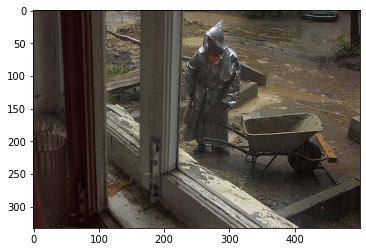

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/996962407.jpg
Real Caption: man in silver raincoat standing outside by wheelbarrow
Predicted Caption: man in blue shirt and black pants is sitting on the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


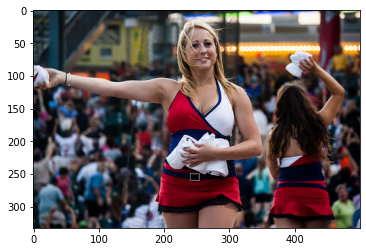

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8008888211.jpg
Real Caption: cheerleader wearing red white and blue is standing with white towels in her hand
Predicted Caption: woman in red tank top and white tank top and white tank top and white tank top
BLEU-1 score: 29.411764705882355
BLEU-2 score: 8.089706346934013e-153
BLEU-3 score: 1.7740382676611615e-183
BLEU-4 score: 1.3416480207402437e-229


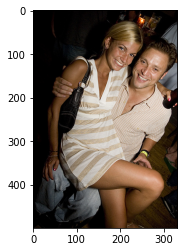

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1141644104.jpg
Real Caption: woman in white and tan striped dress sits in the lap of man with tan collared shirt
Predicted Caption: two girls are posing for picture
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


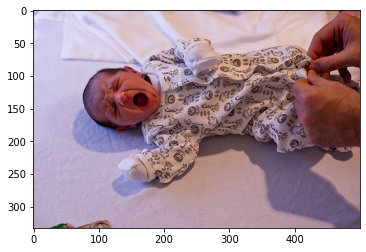

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5504365495.jpg
Real Caption: baby crying about getting their diaper <unk>
Predicted Caption: two children are playing with stuffed animal
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


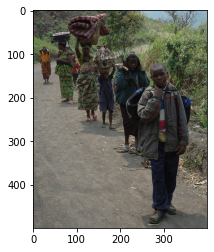

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1318903794.jpg
Real Caption: africans walk down road carrying their belongings
Predicted Caption: group of people are standing in front of them
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


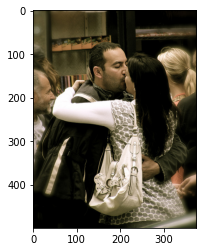

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2500826039.jpg
Real Caption: the couple embrace on the street
Predicted Caption: man and woman are sitting on the camera
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


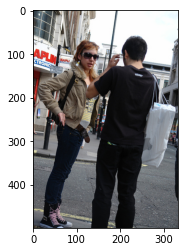

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/846070499.jpg
Real Caption: man talks to woman on city street corner who is wearing high tops with pink <unk>
Predicted Caption: man in blue shirt is walking down the street
BLEU-1 score: 15.314194134530887
BLEU-2 score: 3.9566441369948815e-153
BLEU-3 score: 8.462246762778223e-184
BLEU-4 score: 6.359799333232392e-230


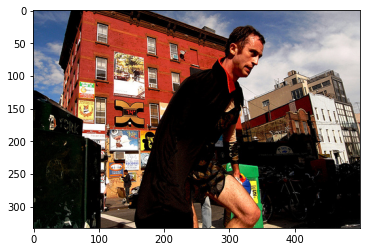

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1398957709.jpg
Real Caption: man wearing bathing trunks and black cape is <unk> forward at an angle
Predicted Caption: man in black shirt is standing in front of the street
BLEU-1 score: 22.73871594750492
BLEU-2 score: 6.494920916966264e-153
BLEU-3 score: 1.4459810340213669e-183
BLEU-4 score: 1.0976852611324292e-229


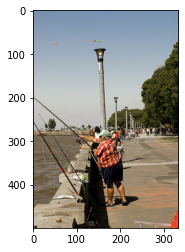

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4519403752.jpg
Real Caption: man in plaid red shirt casts his fishing line out into the water
Predicted Caption: man in red shirt and black pants is standing on the water
BLEU-1 score: 46.00222073146617
BLEU-2 score: 33.97489162917925
BLEU-3 score: 2.561071449847154e-91
BLEU-4 score: 8.339800318341855e-153


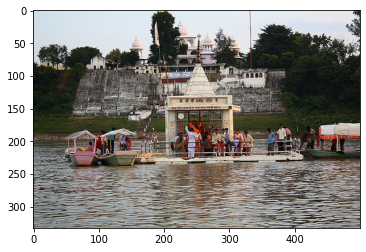

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3240558825.jpg
Real Caption: people wait to board boats
Predicted Caption: two men are sitting on the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


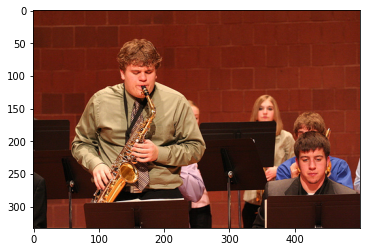

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/381750411.jpg
Real Caption: young man in green shirt and tie playing saxophone
Predicted Caption: man in white shirt is playing the guitar
BLEU-1 score: 44.124845129229776
BLEU-2 score: 23.585721816862673
BLEU-3 score: 2.0233830542837192e-91
BLEU-4 score: 6.805395922591311e-153


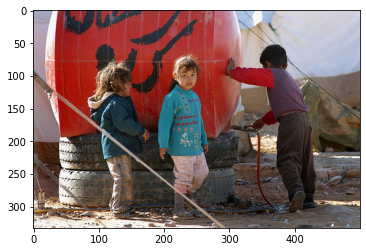

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3060519665.jpg
Real Caption: three kids stand around red apparatus on two tires
Predicted Caption: two men are standing on the street
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229


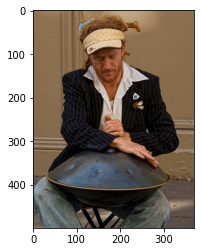

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4119940755.jpg
Real Caption: man in blue striped jacket and jeans is playing drum while sitting outside
Predicted Caption: man in blue shirt and black hat is playing the street
BLEU-1 score: 45.47743189500984
BLEU-2 score: 33.726966161676806
BLEU-3 score: 25.056970407397962
BLEU-4 score: 3.739235363803729e-76


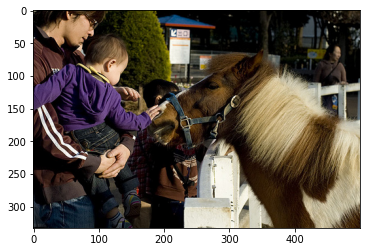

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3289817083.jpg
Real Caption: child and parent pet horse
Predicted Caption: man in blue shirt is standing next to be rodeo
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


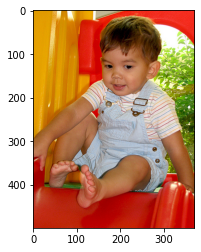

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2576878141.jpg
Real Caption: small child wearing light blue overalls sits on red slide
Predicted Caption: little boy is sitting on the floor
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


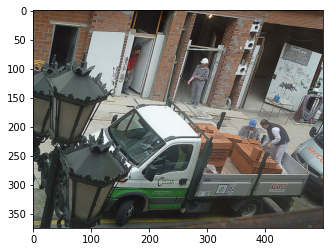

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6378330987.jpg
Real Caption: construction workers stand in street attempting to move bricks
Predicted Caption: two men are standing next to the back of the street
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


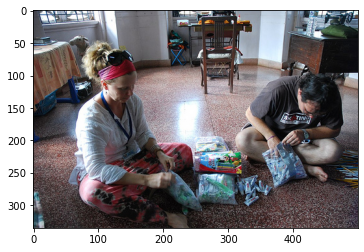

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4302494415.jpg
Real Caption: man and woman are sitting on the floor working with craft items
Predicted Caption: woman in blue shirt is sitting on the ground
BLEU-1 score: 31.845836025501743
BLEU-2 score: 23.884377019126312
BLEU-3 score: 20.674404440962387
BLEU-4 score: 3.106248119711438e-76


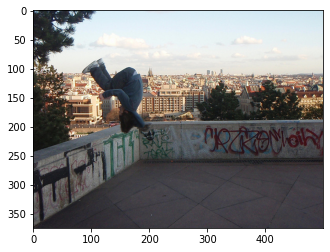

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2373018323.jpg
Real Caption: with an urban landscape in the background and graffiti <unk> the scene young person in blue jeans and sneakers is doing flip several feet in the air
Predicted Caption: man in black shirt and black pants and white picket fence
BLEU-1 score: 6.368358520661273
BLEU-2 score: 1.819011463007515e-153
BLEU-3 score: 4.049712244079026e-184
BLEU-4 score: 3.0742515548702525e-230


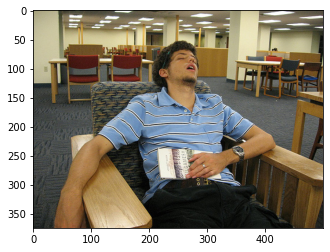

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/223385817.jpg
Real Caption: tired from reading his book young man in striped shirt takes nap in the library
Predicted Caption: man in black shirt and black jacket is sitting on the phone
BLEU-1 score: 25.960026102380162
BLEU-2 score: 13.557181477353206
BLEU-3 score: 1.3806243443894619e-91
BLEU-4 score: 4.846967528675371e-153


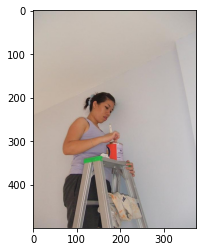

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/192309867.jpg
Real Caption: girl on ladder painting white wall
Predicted Caption: man in red shirt and black pants is sitting on the top of the background
BLEU-1 score: 6.666666666666667
BLEU-2 score: 3.851470592303926e-153
BLEU-3 score: 1.1365257532669032e-183
BLEU-4 score: 9.25732495472854e-230


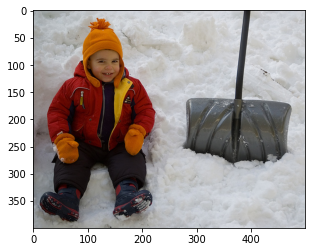

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2113694192.jpg
Real Caption: the child in the red jacket and orange mittens is sitting in the snow next to shovel
Predicted Caption: young boy in winter clothing and blue jacket is sitting in the snow
BLEU-1 score: 45.23947572871905
BLEU-2 score: 33.29535261284078
BLEU-3 score: 30.952598441767748
BLEU-4 score: 23.909302951697416


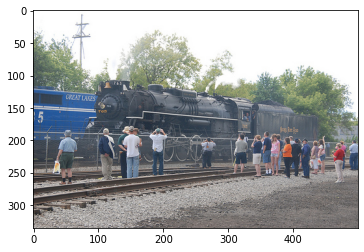

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3848368547.jpg
Real Caption: several people looking at an old train engine
Predicted Caption: people are walking down the side of large building
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


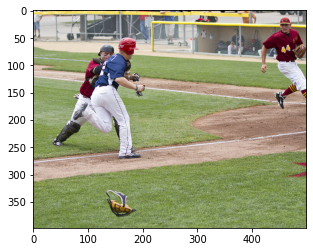

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5903521315.jpg
Real Caption: baseball player wearing blue shirt runs toward the home plate as the opposing team catcher tags him the catcher face mask flies away of the third base <unk> line and the catcher teammate covers the home plate
Predicted Caption: two men are playing cricket
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


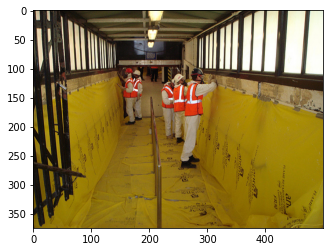

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2537802214.jpg
Real Caption: workers in orange vests putting up yellow drop cloth
Predicted Caption: two men are standing on the ground
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


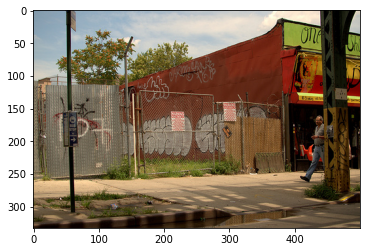

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4835932220.jpg
Real Caption: man walks by building covered with graffiti
Predicted Caption: man in blue shirt and black pants is standing on the background
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


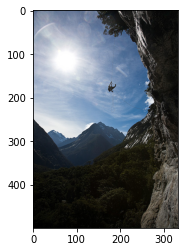

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3462512074.jpg
Real Caption: person <unk> off cliff face
Predicted Caption: person is climbing up the side of mountain
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


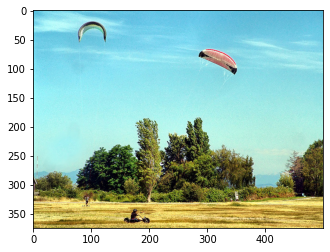

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3726019124.jpg
Real Caption: kites attached to wheeled devices in field
Predicted Caption: two people are standing on the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


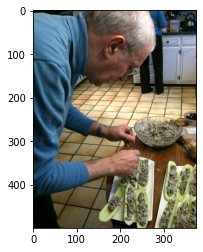

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4484420794.jpg
Real Caption: an older man in blue shirt is <unk> substance onto objects while woman is wearing blue shirt in the background
Predicted Caption: man in blue shirt is holding
BLEU-1 score: 8.080997322033754
BLEU-2 score: 7.917728020712005
BLEU-3 score: 7.876571327724287
BLEU-4 score: 7.368276169123441


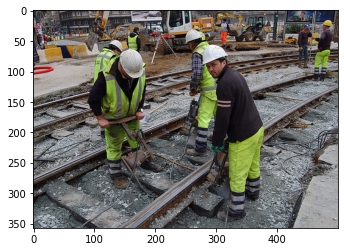

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1749201369.jpg
Real Caption: construction workers fixing railroad track
Predicted Caption: two men are working on the side of the ground
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


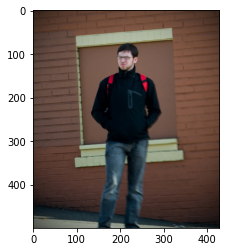

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2234702530.jpg
Real Caption: man with glasses and red backpack standing in front of brick wall
Predicted Caption: man in black coat and black jacket is walking down the street
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


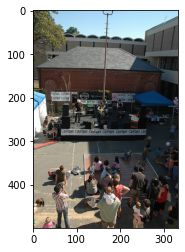

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1487016591.jpg
Real Caption: band playing in front of small crowd outside
Predicted Caption: group of people are sitting on the middle of people
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


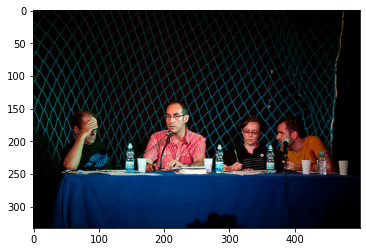

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3643684044.jpg
Real Caption: four people are sitting at table with microphones and bottles of water in front of them
Predicted Caption: three men are sitting at podium
BLEU-1 score: 9.443780141878094
BLEU-2 score: 8.44677374472081
BLEU-3 score: 7.688946955349631
BLEU-4 score: 1.0908234670964951e-76


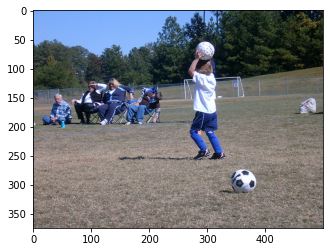

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2455286250.jpg
Real Caption: child holds soccer ball while people watch
Predicted Caption: two young boys playing soccer ball
BLEU-1 score: 28.2160574963538
BLEU-2 score: 21.856064155801842
BLEU-3 score: 1.9010499936561078e-91
BLEU-4 score: 6.416038883891965e-153


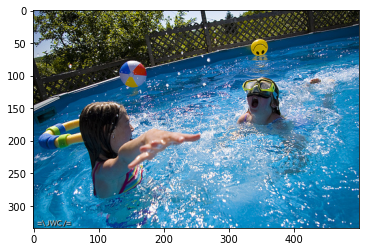

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/554774472.jpg
Real Caption: the children play in the pool
Predicted Caption: two children are playing in the pool
BLEU-1 score: 57.14285714285714
BLEU-2 score: 43.643578047198474
BLEU-3 score: 37.519859868268625
BLEU-4 score: 5.395774370246973e-76


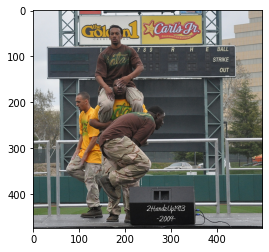

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3438858409.jpg
Real Caption: three men climbing on each other wearing yellow and brown shirts
Predicted Caption: two men are standing on the street
BLEU-1 score: 16.13480348593598
BLEU-2 score: 4.5026679202702836e-153
BLEU-3 score: 9.9315714226985e-184
BLEU-4 score: 7.521821744402224e-230


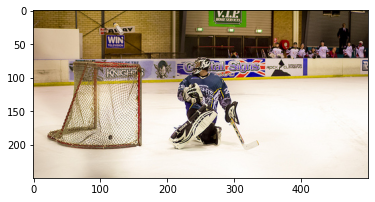

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7320251226.jpg
Real Caption: the goalie turns to see the puck in the net while the team rises from the bench
Predicted Caption: two men are playing game
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


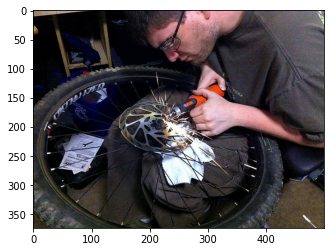

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5661996549.jpg
Real Caption: <unk> using <unk> on bike wheel <unk>
Predicted Caption: man in blue shirt is working on the street
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


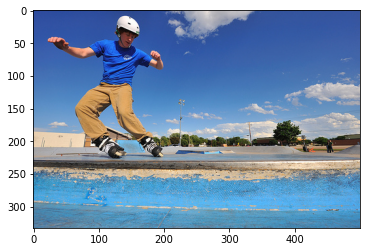

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3061884351.jpg
Real Caption: young male in blue shirt and tan pants rollerblading
Predicted Caption: man in red shirt and black pants and black pants and white shirt and blue sky
BLEU-1 score: 31.25
BLEU-2 score: 14.433756729740645
BLEU-3 score: 1.5842764196060543e-91
BLEU-4 score: 5.667113443314699e-153


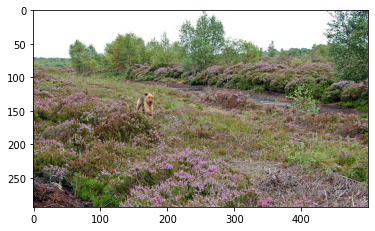

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1184967930.jpg
Real Caption: brown dog running through the grass and flowers
Predicted Caption: person with backpack is walking through the woods
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


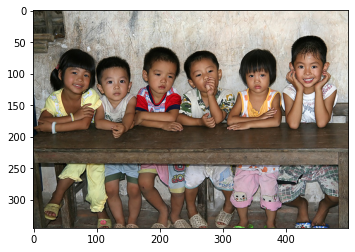

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/979383193.jpg
Real Caption: six small children sitting at desk
Predicted Caption: group of people are sitting on the camera
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


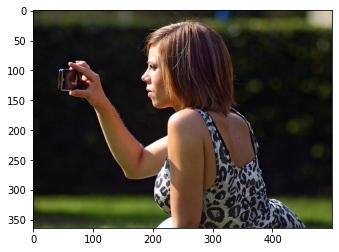

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4895028664.jpg
Real Caption: brunette woman in leopard print shirt taking picture
Predicted Caption: woman in black tank top and white dress is standing in her hair
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153


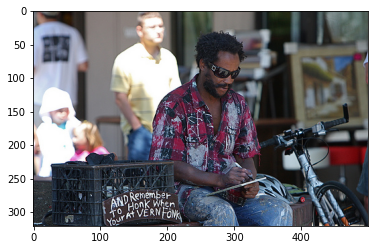

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2695085632.jpg
Real Caption: man is sitting outside writing something on pad of paper
Predicted Caption: man in blue shirt is playing the street
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229


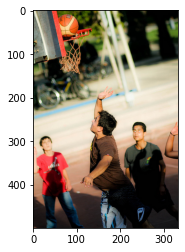

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3250589803.jpg
Real Caption: the guys are shooting hoops
Predicted Caption: two women are standing in front of them are standing in front of people
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


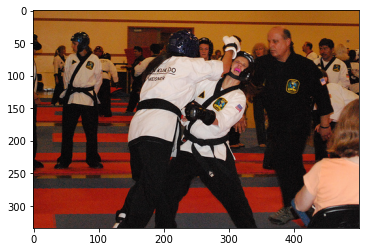

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2701892929.jpg
Real Caption: <unk> <unk> do match in progress
Predicted Caption: two men are playing game
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


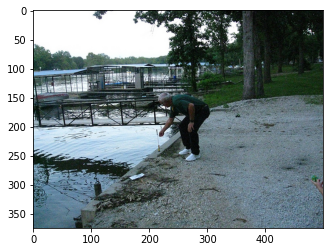

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2653940812.jpg
Real Caption: an old man squats near the water where there are boats docked
Predicted Caption: man in black jacket stands on the water
BLEU-1 score: 22.744899739223754
BLEU-2 score: 14.038456897256543
BLEU-3 score: 1.275663286628331e-91
BLEU-4 score: 4.3526954523912734e-153


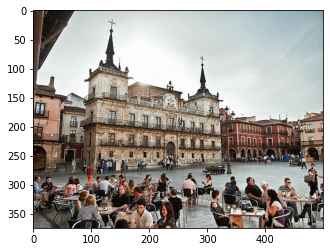

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4663418784.jpg
Real Caption: people are eating in restaurant
Predicted Caption: people are walking down street
BLEU-1 score: 40.0
BLEU-2 score: 31.6227766016838
BLEU-3 score: 2.536315813271983e-91
BLEU-4 score: 8.38826642100846e-153


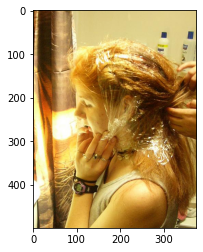

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3288203502.jpg
Real Caption: female with wraps her hair in plastic
Predicted Caption: woman in pink shirt and white polka dot dress
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


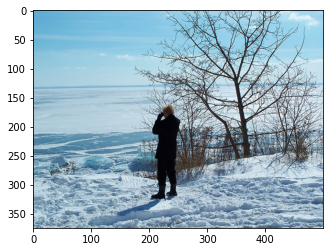

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/415118186.jpg
Real Caption: person taking pictures outside in the snow
Predicted Caption: man in black coat and black jacket and black jacket and holding shovel
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


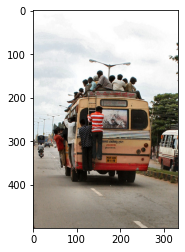

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/349931518.jpg
Real Caption: people holding on to moving bus
Predicted Caption: two men are standing in front of the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


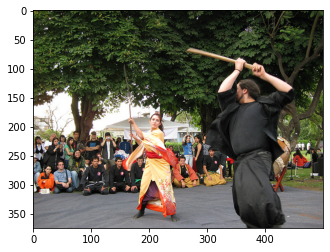

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4158826243.jpg
Real Caption: man and woman perform martial arts demonstration with practice <unk> in front of an audience in an outside park like environment
Predicted Caption: man in red shirt and black pants is playing the street
BLEU-1 score: 10.987917859885442
BLEU-2 score: 3.138508687422518e-153
BLEU-3 score: 6.987343025639227e-184
BLEU-4 score: 5.304290494315929e-230


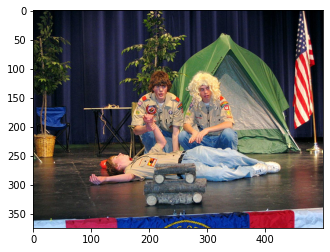

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4390539398.jpg
Real Caption: three kids perform <unk> about camping
Predicted Caption: three women in red and black and black and white and white and black and black and black and black and black and black and black and black and black and black and black and black and black and black and black and black and white dress and black and black and black and black and black and black and black and black and black and black and black and black and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 1.0000000000000004
BLEU-2 score: 1.491668146240076e-153
BLEU-3 score: 6.432897904653522e-184
BLEU-4 score: 5.761138600803475e-230


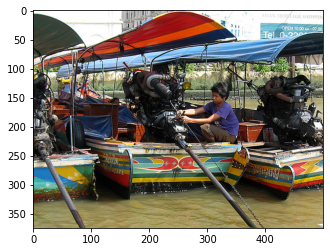

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/363394643.jpg
Real Caption: person in purple shirt tends to the equipment of boat while perched on the edge of the watercraft
Predicted Caption: man in red shirt and black shirt is sitting on the background
BLEU-1 score: 20.21768865708778
BLEU-2 score: 10.558343550803821
BLEU-3 score: 1.0752313205379579e-91
BLEU-4 score: 3.7748221068540505e-153


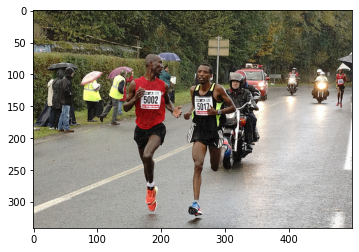

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/8154670501.jpg
Real Caption: two runners one in red shirt and one in black shirt race in front of two men on motorcycle
Predicted Caption: two women in the street
BLEU-1 score: 2.432402505008719
BLEU-2 score: 5.736905049891899e-154
BLEU-3 score: 1.1830418469702335e-184
BLEU-4 score: 8.810463819045427e-231


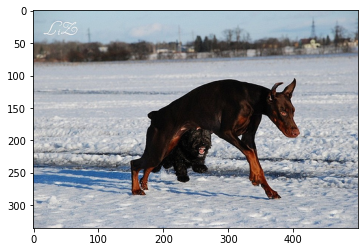

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3266306177.jpg
Real Caption: little black dog and large brown dog are out in the snow
Predicted Caption: two dogs are running through the snow
BLEU-1 score: 20.980356838155135
BLEU-2 score: 13.083551190106055
BLEU-3 score: 1.1224178752497289e-91
BLEU-4 score: 3.7751121892103357e-153


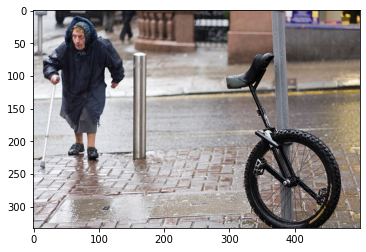

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2193223637.jpg
Real Caption: old lady crossing the street while getting <unk> on
Predicted Caption: man in blue shirt and black pants is walking down the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


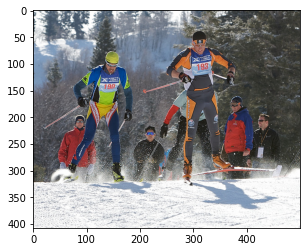

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3371266735.jpg
Real Caption: three skiers are coming over and down hill while spectators are watching
Predicted Caption: group of people are playing game
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230


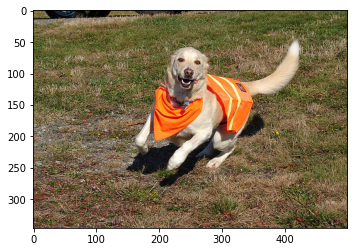

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3028969146.jpg
Real Caption: beige dog with orange vest running on <unk> grass
Predicted Caption: dog with red vest runs through the grass
BLEU-1 score: 44.124845129229776
BLEU-2 score: 23.585721816862673
BLEU-3 score: 2.0233830542837192e-91
BLEU-4 score: 6.805395922591311e-153


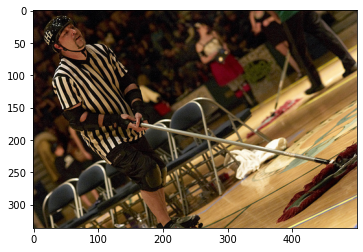

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4433557295.jpg
Real Caption: man in pads and referee shirt sweeps the court floor with spectators in the bleachers behind him
Predicted Caption: man in black shirt and black shirt is sitting on the background
BLEU-1 score: 27.468359591685154
BLEU-2 score: 12.830453363985562
BLEU-3 score: 1.2495859032811668e-91
BLEU-4 score: 4.3382562373312647e-153


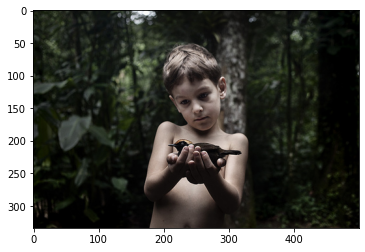

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5334523454.jpg
Real Caption: little boy without shirt on is standing in forest holding small bird in his hands
Predicted Caption: young boy in the grass
BLEU-1 score: 5.413411329464508
BLEU-2 score: 1.2767716991409542e-153
BLEU-3 score: 2.6329080505515765e-184
BLEU-4 score: 1.9608047828287652e-230


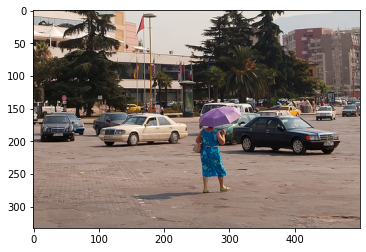

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2736432503.jpg
Real Caption: woman with purple umbrella is in parking lot
Predicted Caption: man in red umbrella is walking down the street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


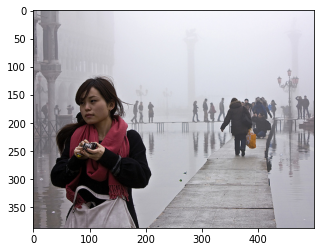

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4478794627.jpg
Real Caption: an asian women with burgundy scarf moves through misty city
Predicted Caption: woman in black dress is walking down the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


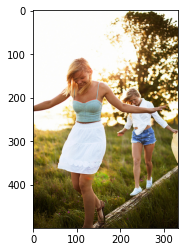

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7347276120.jpg
Real Caption: the family has fun day out pretending to be tightrope walkers
Predicted Caption: woman in red shirt and black pants is holding up to be dancing
BLEU-1 score: 15.384615384615385
BLEU-2 score: 11.322770341445958
BLEU-3 score: 1.36954071726339e-91
BLEU-4 score: 5.019362538473706e-153


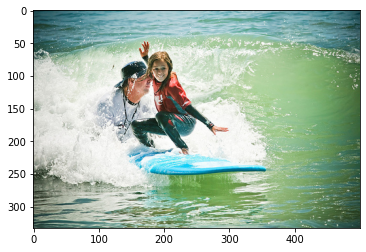

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2696060728.jpg
Real Caption: girl stands on surfboard which man is standing behind and holding
Predicted Caption: man in red shirt and black wetsuit is riding wave
BLEU-1 score: 27.145122541078788
BLEU-2 score: 7.392705315031213e-153
BLEU-3 score: 1.614780837678646e-183
BLEU-4 score: 1.2199981975731961e-229


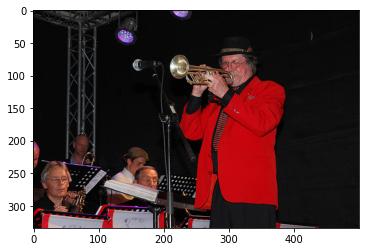

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5135072759.jpg
Real Caption: man in red coat and black hat plays trombone
Predicted Caption: man in red shirt is playing the guitar
BLEU-1 score: 33.09363384692233
BLEU-2 score: 28.886491833271272
BLEU-3 score: 26.378906083081333
BLEU-4 score: 3.940055059819774e-76


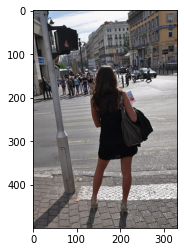

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4693188134.jpg
Real Caption: woman in black dress and heels waiting to cross the street
Predicted Caption: woman in black dress and black jacket and black bag
BLEU-1 score: 45.241870901797974
BLEU-2 score: 42.654444944303584
BLEU-3 score: 42.93546571534697
BLEU-4 score: 35.543339448751695


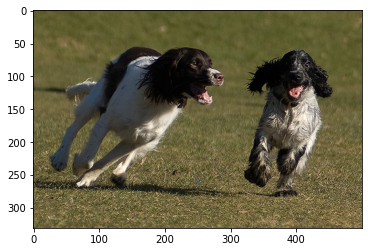

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2272489996.jpg
Real Caption: two <unk> running in grassy area
Predicted Caption: two black dogs are running through field
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


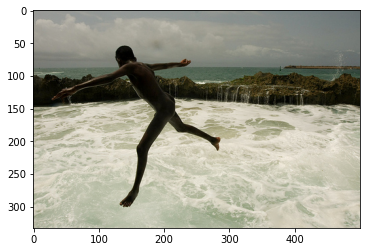

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6762541983.jpg
Real Caption: naked male jumping into <unk> stream
Predicted Caption: man in black shirt and black pants is jumping in the beach
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


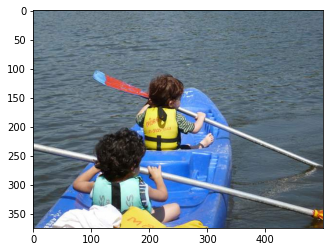

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/5354811242.jpg
Real Caption: two little boys in canoe paddling down the river
Predicted Caption: two young girls are sitting on the water
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229


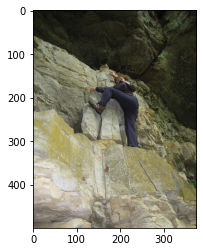

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2555809473.jpg
Real Caption: young woman is rock climbing with no rock climbing gear on
Predicted Caption: man in red shirt is climbing
BLEU-1 score: 14.486606950235942
BLEU-2 score: 3.742824986484746e-153
BLEU-3 score: 8.004942453475685e-184
BLEU-4 score: 6.016112399618114e-230


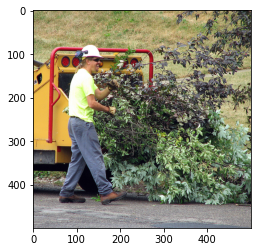

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/572163357.jpg
Real Caption: man wearing yellow shirt and yellow hard hat is working with tree <unk>
Predicted Caption: man in red shirt and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and red and red and red and red and red and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue jeans and blue shirt and blue jeans and blue jeans and blue jeans and blue shirt and blue
BLEU-1 score: 2.9999999999999996
BLEU-2 score: 1.7407765595569784
BLEU-3 score: 4.4529636244159466e-92
BLEU-4 score: 1.968084453516327e-153


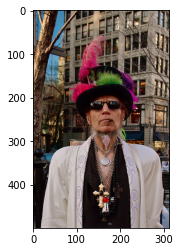

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4580275036.jpg
Real Caption: man in <unk> with beard wearing black top hat with pink green purple and pink feathers
Predicted Caption: man in red hat and red bandanna
BLEU-1 score: 15.797316950260823
BLEU-2 score: 8.531526240433639
BLEU-3 score: 6.90983886840523e-92
BLEU-4 score: 2.2908479845210013e-153


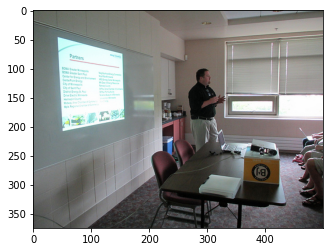

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7754455550.jpg
Real Caption: man is standing before classroom and speaking
Predicted Caption: man in black shirt is sitting in front of an apple laptop
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


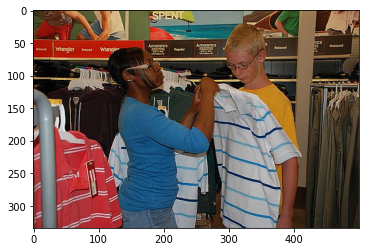

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4881829141.jpg
Real Caption: woman in blue wearing glasses holds up blue and white striped shirt to boy wearing yellow who also has glasses
Predicted Caption: man and woman are standing in front of an outdoor event
BLEU-1 score: 12.033631847999562
BLEU-2 score: 3.437198801246288e-153
BLEU-3 score: 7.652324547601456e-184
BLEU-4 score: 5.8090968495924825e-230


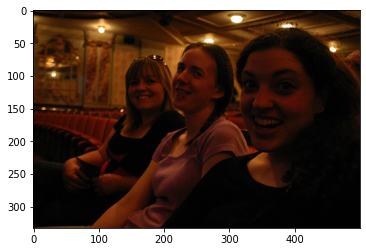

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/190878894.jpg
Real Caption: three young women smiling for photo
Predicted Caption: three women are sitting on the camera
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


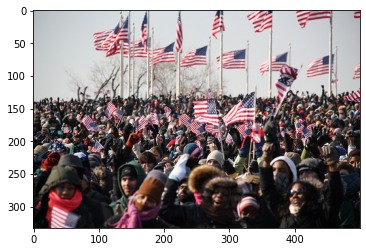

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3216085740.jpg
Real Caption: the crowd is waving many american flags
Predicted Caption: group of people are gathered in front of people
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


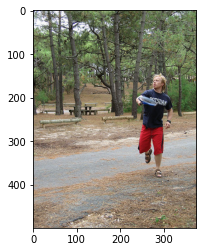

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/27323284.jpg
Real Caption: man is standing in park by path holding tennis racket in front of him
Predicted Caption: young boy in blue shirt and blue shorts and blue shorts and blue shirt and blue shirt
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230


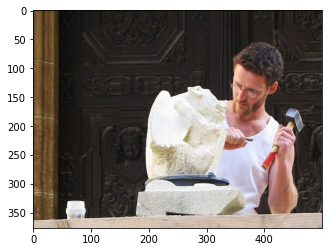

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2865725777.jpg
Real Caption: man looks <unk> while sculpting <unk>
Predicted Caption: man in blue shirt and blue shirt is sitting on the floor
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


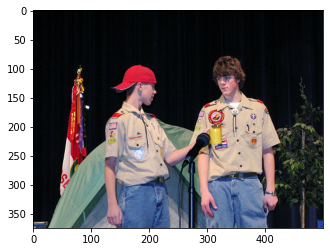

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4390538512.jpg
Real Caption: two older boy scouts are standing in front of microphone
Predicted Caption: two men are standing in front of building
BLEU-1 score: 58.41005873035536
BLEU-2 score: 50.984479138794214
BLEU-3 score: 49.05963866822961
BLEU-4 score: 42.13952948452608


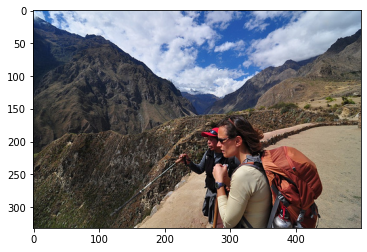

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3826417429.jpg
Real Caption: two women look at mountain view
Predicted Caption: man and woman are sitting on rock
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


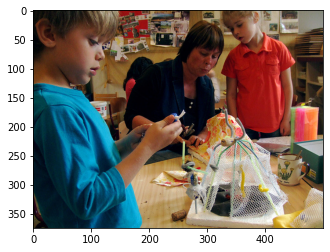

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/513390919.jpg
Real Caption: teacher and school children work on art projects
Predicted Caption: two young girls are sitting at table
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


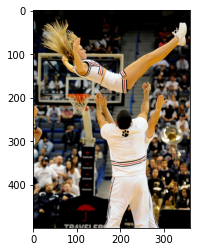

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3069786374.jpg
Real Caption: the two men throw the cheerleader in the air
Predicted Caption: man in red shirt and black and white pants and white outfit
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


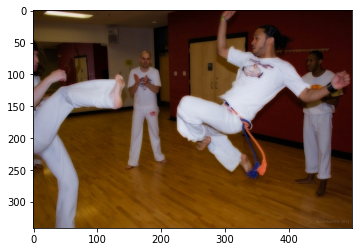

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/533363682.jpg
Real Caption: two male in karate class one who is in the air with blue and orange belt and one who is about to get kicked in the face
Predicted Caption: two men are doing martial arts
BLEU-1 score: 0.5032897237053084
BLEU-2 score: 1.8389329893535068e-154
BLEU-3 score: 4.517837407849082e-185
BLEU-4 score: 3.5151173180525604e-231


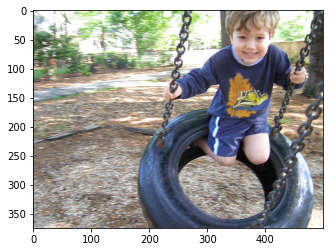

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/136644343.jpg
Real Caption: young boy swinging on tire swing
Predicted Caption: young boy is playing with his head
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


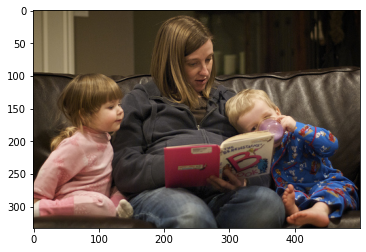

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4270731854.jpg
Real Caption: woman sits on leather sofa reading book to her boy and girl
Predicted Caption: woman is sitting on the floor
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230


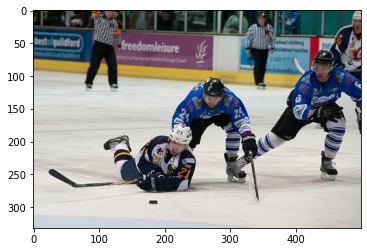

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7036852925.jpg
Real Caption: professional hockey players are eagerly fighting for the puck
Predicted Caption: two men are playing game
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


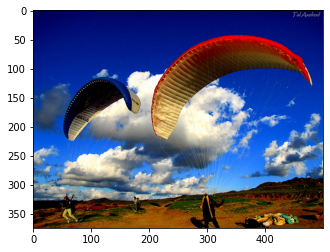

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4233715648.jpg
Real Caption: two people landing on the ground with red and blue parachutes
Predicted Caption: two people are flying through the ground
BLEU-1 score: 32.26960697187196
BLEU-2 score: 24.646319432512993
BLEU-3 score: 1.7377498633415093e-91
BLEU-4 score: 5.564986491747261e-153


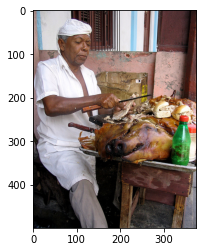

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/47082665.jpg
Real Caption: man in white jacket and hate slices <unk> for sandwiches
Predicted Caption: man in blue shirt and white shirt is sitting on the camera
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


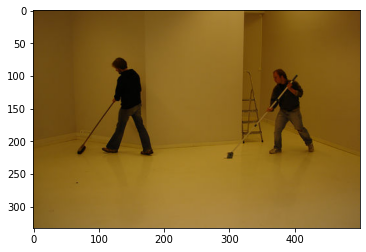

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/574181.jpg
Real Caption: two men are sweeping in white room
Predicted Caption: two men are playing with his arms outstretched while another man in the floor
BLEU-1 score: 28.57142857142857
BLEU-2 score: 20.965696734438367
BLEU-3 score: 18.584513891213202
BLEU-4 score: 3.0046607657263396e-76


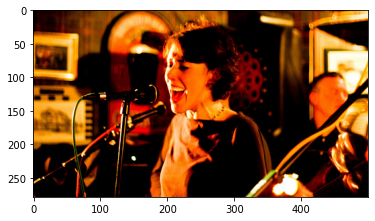

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2354007039.jpg
Real Caption: young woman is singing into microphone
Predicted Caption: man in red shirt is singing into microphone
BLEU-1 score: 50.0
BLEU-2 score: 46.29100498862758
BLEU-3 score: 45.30661222656875
BLEU-4 score: 34.5720784641941


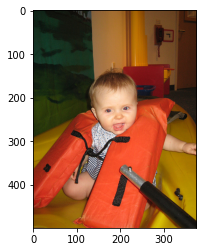

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2615811117.jpg
Real Caption: happy baby wears an orange life vest
Predicted Caption: little boy is playing with his mouth
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


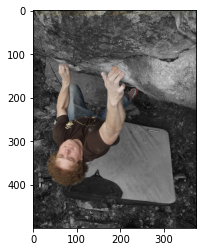

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2522230304.jpg
Real Caption: man with dark brown shirt is climbing up rocky <unk>
Predicted Caption: man in blue shirt is sitting on the ground
BLEU-1 score: 29.827977227145652
BLEU-2 score: 18.26583106646588
BLEU-3 score: 1.745359983331643e-91
BLEU-4 score: 6.030654703641958e-153


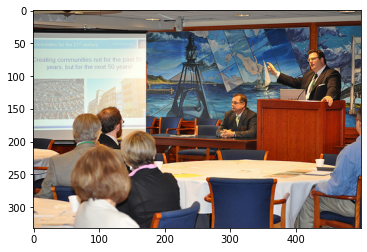

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4459039661.jpg
Real Caption: man in suit standing behind podium <unk> to group of people sitting at tables
Predicted Caption: group of people are sitting at table
BLEU-1 score: 26.277102940817308
BLEU-2 score: 21.985001643702848
BLEU-3 score: 16.66737118728135
BLEU-4 score: 2.322788231679662e-76


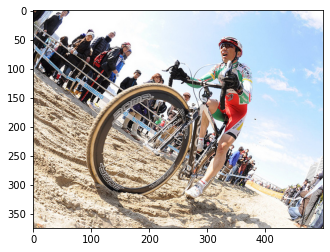

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6881071903.jpg
Real Caption: bike rider with suit covered in advertisement prepares for race
Predicted Caption: man in blue shirt and black helmet is on the background
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


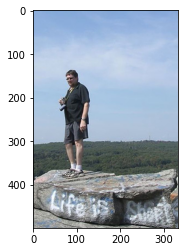

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/247097023.jpg
Real Caption: man in black standing on rock with the <unk> life is short spray painted on it
Predicted Caption: man in red shirt and black jacket stands on rock
BLEU-1 score: 27.44058180470132
BLEU-2 score: 18.29372120313421
BLEU-3 score: 1.436659627187671e-91
BLEU-4 score: 4.726448163471526e-153


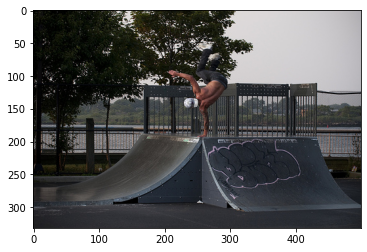

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3728015645.jpg
Real Caption: young man is skateboarding on ramp and is standing on one arm
Predicted Caption: man in black shirt and black pants and black pants and white picket fence
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


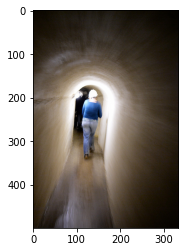

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2545723691.jpg
Real Caption: woman walking the hall of <unk> basement as the family vacation <unk> <unk> <unk>
Predicted Caption: two people are standing in the snow
BLEU-1 score: 5.255420588163462
BLEU-2 score: 2.0740953307181176e-153
BLEU-3 score: 5.255121541612728e-184
BLEU-4 score: 4.120399555529536e-230


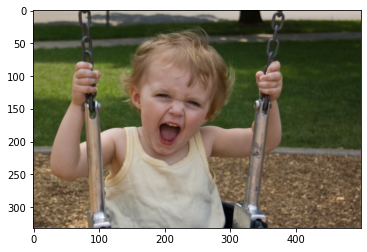

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2726180005.jpg
Real Caption: very happy baby in yellow shirt swinging on swing
Predicted Caption: young boy in blue shirt is playing with his head
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


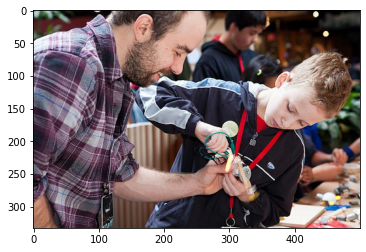

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/7024546693.jpg
Real Caption: man in plaid shirt and younger boy in black jacket working on something
Predicted Caption: man in blue shirt is holding up to be
BLEU-1 score: 21.37267961433182
BLEU-2 score: 13.088039872774232
BLEU-3 score: 1.2506050762796693e-91
BLEU-4 score: 4.321152918418559e-153


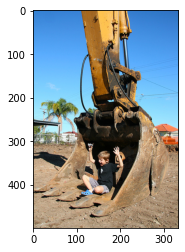

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/1429383749.jpg
Real Caption: little boy is sitting in the bucket of piece of machinery
Predicted Caption: man in blue shirt and blue sky
BLEU-1 score: 8.06740174296799
BLEU-2 score: 3.183867019854334e-153
BLEU-3 score: 8.066942687669913e-184
BLEU-4 score: 6.325072941044999e-230


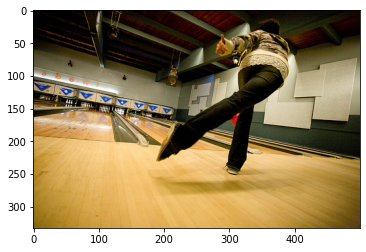

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3142787646.jpg
Real Caption: woman watches as her bowling ball rolls down the lane toward pins
Predicted Caption: man in black shirt and black pants is standing on the background
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


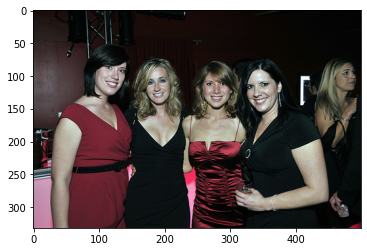

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3044500219.jpg
Real Caption: four girls in evening attire pose for picture
Predicted Caption: three women are posing for picture
BLEU-1 score: 23.88437701912631
BLEU-2 score: 18.500758885923073
BLEU-3 score: 1.609204077733313e-91
BLEU-4 score: 5.431059661402121e-153


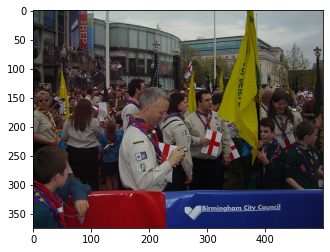

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/468610158.jpg
Real Caption: group of people are standing outside
Predicted Caption: man in red shirt is standing in front of people
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


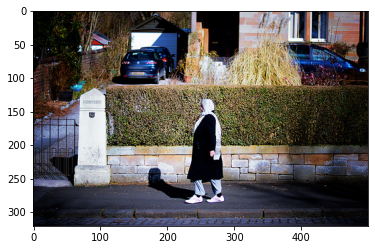

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4444432883.jpg
Real Caption: muslim woman is walking down the street
Predicted Caption: woman in black jacket and black pants and black pants and black and black and black jacket
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230


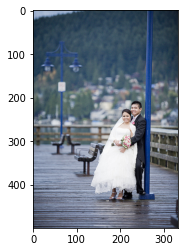

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3052435954.jpg
Real Caption: newlywed couple standing on pier
Predicted Caption: bride and groom are standing in front of the street
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


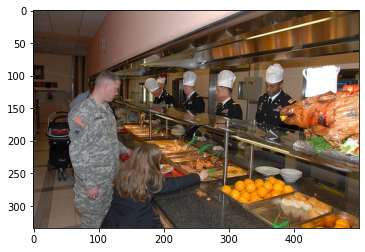

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/4146150983.jpg
Real Caption: army men ordering food at restaurant
Predicted Caption: man in blue shirt is standing in front of
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


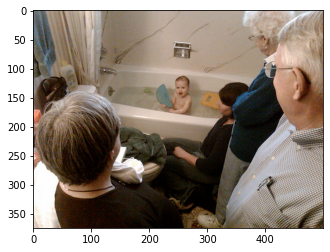

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3419238351.jpg
Real Caption: bunch of people watching child in the bathtub
Predicted Caption: two men are sitting on the floor
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


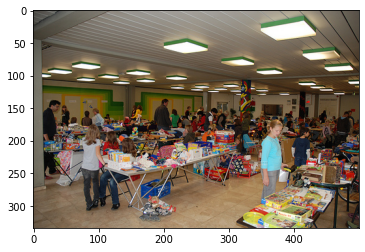

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/2836926422.jpg
Real Caption: young people gather in cluttered store
Predicted Caption: people are sitting in front of
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


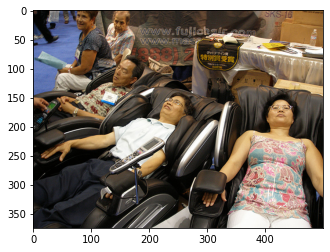

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/255091927.jpg
Real Caption: people laying in <unk> chairs
Predicted Caption: two women are sitting on the floor
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


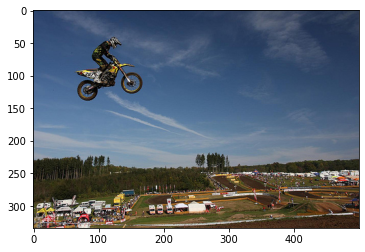

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6181931777.jpg
Real Caption: professional dirt biker attempts large jump
Predicted Caption: man in black shirt is jumping his bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


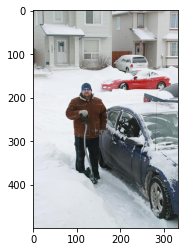

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/3105004381.jpg
Real Caption: man tired of the snow that had hit the city of <unk> <unk> last <unk>
Predicted Caption: two people are shoveling snow with dog sled through the snow
BLEU-1 score: 12.638980516343251
BLEU-2 score: 9.37331881837364
BLEU-3 score: 1.0572294601478943e-91
BLEU-4 score: 3.807643477730697e-153


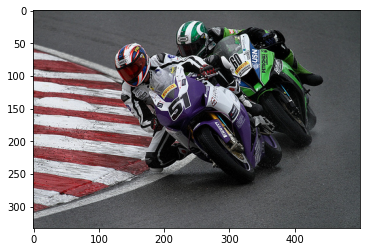

image /content/drive/MyDrive/Project_Data/Flickr30k/Flickr30_images/6924031104.jpg
Real Caption: two gentleman one on purple motorcycle one on green one racing around tight right hand turn
Predicted Caption: two men are racing on the street
BLEU-1 score: 11.847987712695618
BLEU-2 score: 2.6996359539172135e-153
BLEU-3 score: 5.490792144363403e-184
BLEU-4 score: 4.0750740756837155e-230
BLEU-1 count: 128
BLEU-2 count: 59
BLEU-3 count: 17
BLEU-4 count: 7
BLEU-1 Total: 31.13718708773293
BLEU-2 Total: 13.434201597956577
BLEU-3 Total: 5.114246295442624
BLEU-4 Total: 2.1175557471966857
BLEU-1 Average: 0.2432592741229135
BLEU-2 Average: 0.22769833216875554
BLEU-3 Average: 0.30083801737897786
BLEU-4 Average: 0.3025079638852408


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [82]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(200):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print("image",image)
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""